<a href="https://colab.research.google.com/github/ulkuhos/Sayisal_Goruntu_Isleme_2024/blob/main/Ulku_DIP_MIDTERM_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# MIDTERM

**Not**: Gökalp hocam, verdiğiniz bu proje dosyası üzerinde çalışarak çalışmalarımı word dokumanı üzerinde vize için istediğiniz yönergelere uygun şekilde gerçekleştirdim.

## VERI YUKLEME

Bu dersin arasınavında , [ChestX-ray8 dataset](https://arxiv.org/abs/1705.02315) veri seti'nden alınan göğüs röntgeni görüntüleriyle çalışıyoruz.
<img src="https://raw.githubusercontent.com/hardik0/AI-for-Medicine-Specialization/master/AI-for-Medical-Diagnosis/Week-1/xray-image.png" alt="U-net Image" width="300" align="middle"/>



1-Kütüphanelerin içe aktarılması:

o	Veri işleme için pandas, sayısal işlemler için numpy, görselleştirme için matplotlib ve seaborn kütüphaneleri.

o	os modülünü kullanarak dosya yolunu belirtme.


In [ ]:
# Import necessary packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import seaborn as sns
sns.set()

2-Veri Setinin Yüklenmesi

o	train_df olarak adlandırılan veri çerçevesine CSV dosyasını yükleyin ve ilk birkaç satırı inceleme.

o	Toplam satır ve sütun sayısını ekrana yazdırma.


In [ ]:
!git clone https://github.com/hardik0/AI-for-Medicine-Specialization
%cd AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/

Cloning into 'AI-for-Medicine-Specialization'...
remote: Enumerating objects: 1601, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 1601 (delta 9), reused 2 (delta 0), pack-reused 1573 (from 1)
Receiving objects: 100% (1601/1601), 720.36 MiB | 21.15 MiB/s, done.
Resolving deltas: 100% (30/30), done.
Updating files: 100% (1497/1497), done.
/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis


In [ ]:
%ls nih/

densenet.hdf5  images_small/  pretrained_model.h5  test.csv  train-small.csv  valid-small.csv


o	Toplam satır ve sütun sayısını ekrana yazdırma.

In [ ]:
# Read csv file containing training datadata
train_df = pd.read_csv("nih/train-small.csv")
# Print first 5 rows
print(f'There are {train_df.shape[0]} rows and {train_df.shape[1]} columns in this data frame')
train_df.head()

There are 1000 rows and 16 columns in this data frame


,Image,Atelectasis,Cardiomegaly,Consolidation,Edema,Effusion,Emphysema,Fibrosis,Hernia,Infiltration,Mass,Nodule,PatientId,Pleural_Thickening,Pneumonia,Pneumothorax
0,00008270_015.png,0,0,0,0,0,0,0,0,0,0,0,8270,0,0,0
1,00029855_001.png,1,0,0,0,1,0,0,0,1,0,0,29855,0,0,0
2,00001297_000.png,0,0,0,0,0,0,0,0,0,0,0,1297,1,0,0
3,00012359_002.png,0,0,0,0,0,0,0,0,0,0,0,12359,0,0,0
4,00017951_001.png,0,0,0,0,0,0,0,0,1,0,0,17951,0,0,0


Have a look at the various columns in this csv file. The file contains the names of chest x-ray images ("Image" column) and the columns filled with ones and zeros identify which diagnoses were given based on each x-ray image.

3-Veri Özelliklerinin İncelenmesi

o	Sütunlardaki veri türlerini ve eksik değerleri inceleme: Eksik değerler bulunmamaktadır.

o	PatientId sütunundaki benzersiz hasta sayısını analiz edin ve her bir hastanın birden fazla görüntüsü olup olmadığını belirleme.


### Data types and null values check
Run the next cell to explore the data types present in each column and whether any null values exist in the data.

In [ ]:
# Look at the data type of each column and whether null values are present
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Image               1000 non-null   object
 1   Atelectasis         1000 non-null   int64 
 2   Cardiomegaly        1000 non-null   int64 
 3   Consolidation       1000 non-null   int64 
 4   Edema               1000 non-null   int64 
 5   Effusion            1000 non-null   int64 
 6   Emphysema           1000 non-null   int64 
 7   Fibrosis            1000 non-null   int64 
 8   Hernia              1000 non-null   int64 
 9   Infiltration        1000 non-null   int64 
 10  Mass                1000 non-null   int64 
 11  Nodule              1000 non-null   int64 
 12  PatientId           1000 non-null   int64 
 13  Pleural_Thickening  1000 non-null   int64 
 14  Pneumonia           1000 non-null   int64 
 15  Pneumothorax        1000 non-null   int64 
dtypes: int64(15), object(1)
m

### Unique IDs check
"PatientId" has an identification number for each patient. One thing you'd like to know about a medical dataset like this is if you're looking at repeated data for certain patients or whether each image represents a different person.

In [ ]:
print(f"The total patient ids are {train_df['PatientId'].count()}, from those the unique ids are {train_df['PatientId'].value_counts().shape[0]} ")

The total patient ids are 1000, from those the unique ids are 928 


o PatientId sütunundaki benzersiz hasta sayısını analiz edin ve her bir hastanın birden fazla görüntüsü olup olmadığını belirleme.

*Sonuçta şunu görüyoruz: *

Veri kümesinde toplam 1000 hasta kaydı (satır) var. Bu hasta kayıtları içinde 928 benzersiz hasta kimliği (unique PatientId) var. 928 benzersiz hasta kimliği olması demek, aynı hastaya ait birden fazla kaydın bulunduğunu gösteriyor (bazı "PatientId" değerleri birden fazla kez tekrar ediyor).

As you can see, the number of unique patients in the dataset is less than the total number so there must be some overlap. For patients with multiple records, you'll want to make sure they do not show up in both training and test sets in order to avoid data leakage (covered later in this week's lectures).

### Explore data labels
Run the next two code cells to create a list of the names of each patient condition or disease.

In [ ]:
columns = train_df.keys()
columns = list(columns)
print(columns)

['Image', 'Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'PatientId', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


In [ ]:
# Remove unnecesary elements
columns.remove('Image')
columns.remove('PatientId')
# Get the total classes
print(f"There are {len(columns)} columns of labels for these conditions: {columns}")

There are 14 columns of labels for these conditions: ['Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


Run the next cell to print out the number of positive labels (1's) for each condition

In [ ]:
# Print out the number of positive labels for each class
for column in columns:
    print(f"The class {column} has {train_df[column].sum()} samples")

The class Atelectasis has 106 samples
The class Cardiomegaly has 20 samples
The class Consolidation has 33 samples
The class Edema has 16 samples
The class Effusion has 128 samples
The class Emphysema has 13 samples
The class Fibrosis has 14 samples
The class Hernia has 2 samples
The class Infiltration has 175 samples
The class Mass has 45 samples
The class Nodule has 54 samples
The class Pleural_Thickening has 21 samples
The class Pneumonia has 10 samples
The class Pneumothorax has 38 samples


Have a look at the counts for the labels in each class above. Does this look like a balanced dataset?

Hayır, bu dengeli bir veri seti değil. Bazı sınıflar, örneğin; Hernia ve Pneumonia, çok az örneğe sahipken, diğer sınıflar, örneğin; Infiltration ve Effusion, çok fazla örneğe sahip. Bu dengesizlik, modelin az örneğe sahip sınıfları öğrenmekte zorlanmasına neden olabilir. Bu durumlarda verileri artırma, örnek dengeleme, denegeleyici kayıp fonksiyonları kullanma ya da sınıf ağırlıklarına dikkat etme gibi durumlar sağlanarak çözümler üretilebilir.

### Data Visualization
Using the image names listed in the csv file, you can retrieve the image associated with each row of data in your dataframe.

Run the cell below to visualize a random selection of images from the dataset.

#2. Görüntü Yükleme ve Görselleştirme
1-Rastgele Görüntüler Seçme

o	train_df içindeki "Image" sütunundan rastgele 9 görüntü seçme.

o	Bu görüntüleri yan yana görselleştirerek veri setindeki örnek görüntüleri inceleme.


Display Random Images


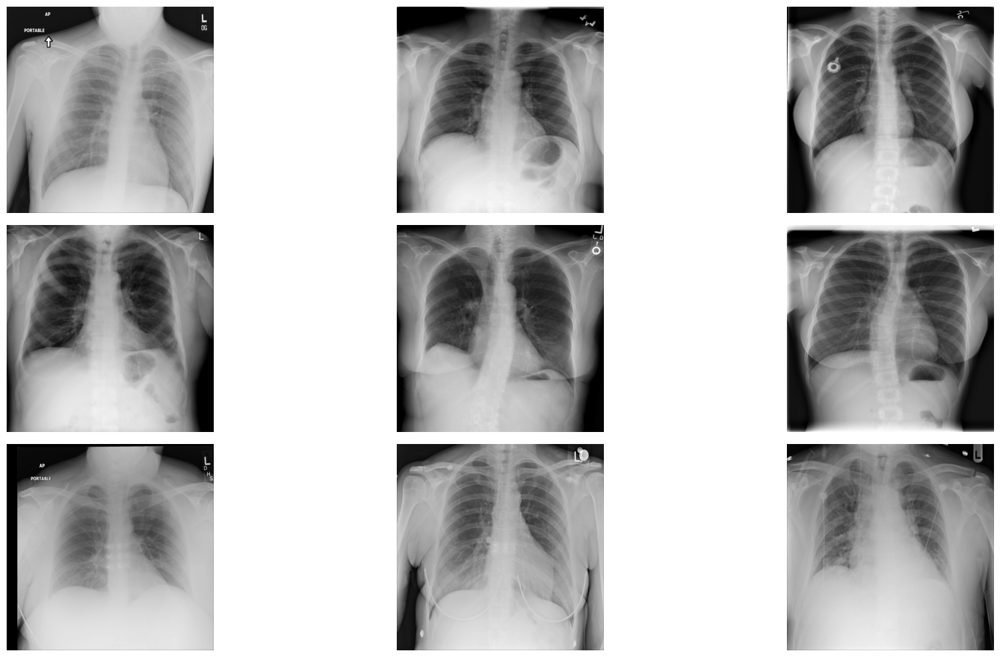

In [ ]:
# Extract numpy values from Image column in data frame
images = train_df['Image'].values

# Extract 9 random images from it
random_images = [np.random.choice(images) for i in range(9)]

# Location of the image dir
img_dir = 'nih/images_small/'

print('Display Random Images')

# Adjust the size of your images
plt.figure(figsize=(20,10))

# Iterate and plot random images
for i in range(9):
    plt.subplot(3, 3, i + 1)
    img = plt.imread(os.path.join(img_dir, random_images[i]))
    plt.imshow(img, cmap='gray')
    plt.axis('off')

# Adjust subplot parameters to give specified padding
plt.tight_layout()

**BEN RASTGELE GELEN GÖRÜNTÜLERİN, GÖRÜNTÜ NUMARALARINI ALDIM VE EKRANA İLK HALLERİNİ YAZDIRIYORUM:**

Display Original Images


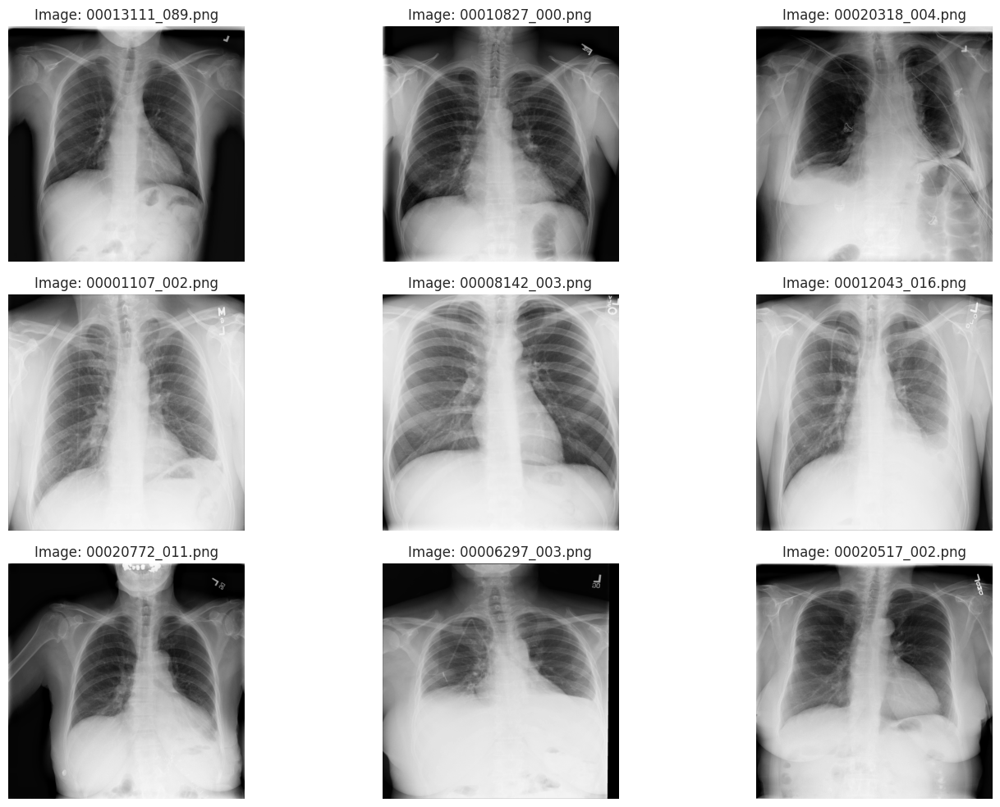

In [ ]:
import matplotlib.pyplot as plt
import os
from skimage.io import imread

# Görüntülerin bulunduğu klasörün yolu
img_dir = 'nih/images_small/'  # Görüntülerin olduğu dizin

# Görüntü dosya adları
image_list = [
    "00013111_089.png",
    "00010827_000.png",
    "00020318_004.png",
    "00001107_002.png",
    "00008142_003.png",
    "00012043_016.png",
    "00020772_011.png",
    "00006297_003.png",
    "00020517_002.png"
]

# Görüntüleri ekrana basma
print('Display Original Images')

# Adjust the size of your images
plt.figure(figsize=(15, 10))

# Iterate and plot original images
for i in range(9):
    plt.subplot(3, 3, i + 1)
    img = imread(os.path.join(img_dir, image_list[i]))
    plt.imshow(img, cmap='gray')
    plt.axis('off')
    plt.title(f"Image: {image_list[i]}")

# Adjust subplot parameters to give specified padding
plt.tight_layout()
plt.show()


2-Rastgele Görüntülerin İstatistiksel Özelliklerini Hesaplama

o	Seçilen görüntülerin her biri için maksimum, minimum, ortalama ve standart sapma değerlerini hesaplama:


### **RASTGELE SECİLMİŞ 9 GÖRÜNTÜNÜN ISTATISTIKSEL ÖZELLİKLERİNİ (MAKSIMUM, MINIMUM, MEAN VE STD) HESAPLAYIN. ORNEK OLARAK BIR GORUNTU ICIN HESAPLAMA YAPILMISTIR.**

The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 0.9804 and the minimum is 0.0000
The mean value of the pixels is 0.4796 and the standard deviation is 0.2757


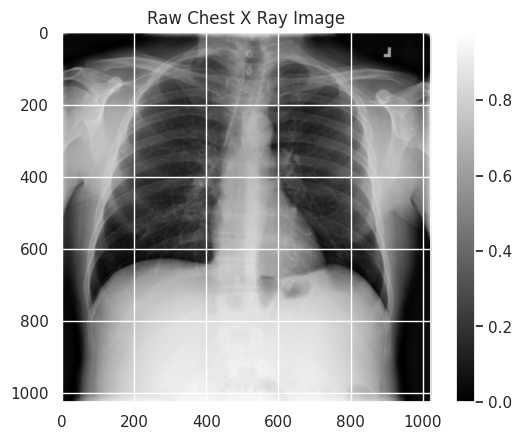

In [ ]:
sample_img = train_df.Image[0]
raw_image = plt.imread(os.path.join(img_dir, sample_img))
plt.imshow(raw_image, cmap='gray')
plt.colorbar()
plt.title('Raw Chest X Ray Image')
print(f"The dimensions of the image are {raw_image.shape[0]} pixels width and {raw_image.shape[1]} pixels height, one single color channel")
print(f"The maximum pixel value is {raw_image.max():.4f} and the minimum is {raw_image.min():.4f}")
print(f"The mean value of the pixels is {raw_image.mean():.4f} and the standard deviation is {raw_image.std():.4f}")

### **CEVAP:  AŞAĞIDA; RASTGELE SECİLMİŞ 9 GÖRÜNTÜNÜN ISTATISTIKSEL ÖZELLİKLERİNİ (MAKSIMUM, MINIMUM, MEAN VE STD) HESAPLADIM.**

### **Bunları yukarıda rasgele gelen görüntülere uyguladım. Onları bir diziye atadım. Sonraki işlemlerde de kullandım.**


Image 1: 00013111_089.png
The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 255.0000
The minimum pixel value is 0.0000
The mean value of the pixels is 105.6965
The standard deviation of the pixels is 68.8102

Image 2: 00010827_000.png
The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 255.0000
The minimum pixel value is 0.0000
The mean value of the pixels is 108.5053
The standard deviation of the pixels is 65.2665

Image 3: 00020318_004.png
The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 248.0000
The minimum pixel value is 0.0000
The mean value of the pixels is 130.0811
The standard deviation of the pixels is 63.8455

Image 4: 00001107_002.png
The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel v

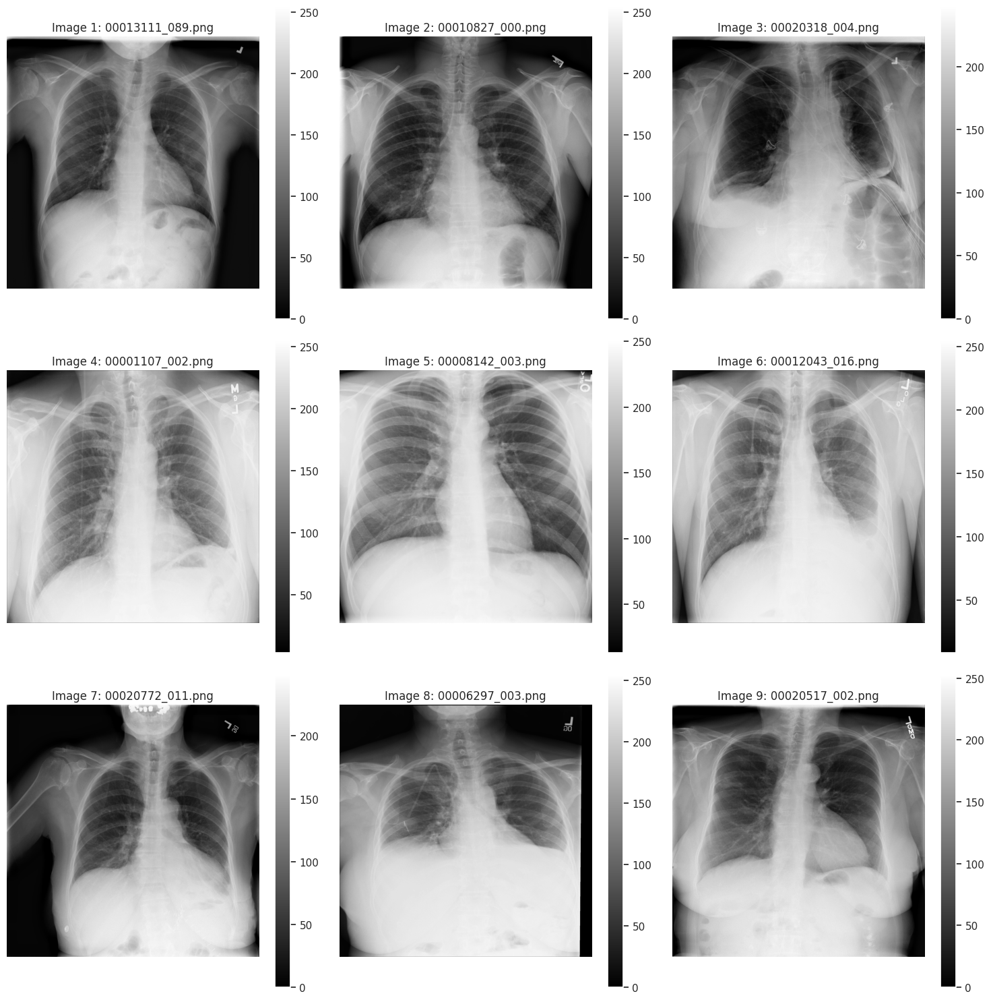

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from skimage.io import imread

# Görüntülerin bulunduğu klasörün yolu
img_dir = 'nih/images_small/'  # Görüntülerin olduğu dizin

# Seçtiğiniz 9 görüntü dosya adları
image_list = [
    "00013111_089.png",
    "00010827_000.png",
    "00020318_004.png",
    "00001107_002.png",
    "00008142_003.png",
    "00012043_016.png",
    "00020772_011.png",
    "00006297_003.png",
    "00020517_002.png"
]

# 9 Görüntüyü işle ve görselleştir
plt.figure(figsize=(15, 15))  # Tüm görüntüleri göstermek için büyük bir figür boyutu
for i, img_name in enumerate(image_list):
    # Görüntünün yolunu oluştur
    img_path = os.path.join(img_dir, img_name)

    # Görüntüyü yükle
    raw_image = imread(img_path)

    # Görüntüyü görselleştir
    plt.subplot(3, 3, i + 1)  # 3x3 gridde görüntüleri yerleştir
    plt.imshow(raw_image, cmap='gray')
    plt.colorbar()
    plt.title(f'Image {i+1}: {img_name}')
    plt.axis('off')

    # İstatistiksel özellikleri hesapla
    max_val = raw_image.max()
    min_val = raw_image.min()
    mean_val = raw_image.mean()
    std_val = raw_image.std()

    # Sonuçları ekrana yazdır
    print(f"\nImage {i+1}: {img_name}")
    print(f"The dimensions of the image are {raw_image.shape[0]} pixels width and {raw_image.shape[1]} pixels height, one single color channel")
    print(f"The maximum pixel value is {max_val:.4f}")
    print(f"The minimum pixel value is {min_val:.4f}")
    print(f"The mean value of the pixels is {mean_val:.4f}")
    print(f"The standard deviation of the pixels is {std_val:.4f}")

plt.tight_layout()  # Görüntülerin çakışmasını önlemek için
plt.show()


3-Histogram Çizimi

o	Seçilen 9 görüntünün her biri için piksel yoğunluk dağılımını gösteren histogramlar oluşturma.

### **RASTGELE SECILMIS 9 GORUNTUNUN HISTOGRAMINI CIZDIRIN. ORNEK OLARAK BIR GORUNTU ICIN VERILMISTIR.**

<ipython-input-17-5170b570a150>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(raw_image.ravel(),


Text(0, 0.5, '# Pixels in Image')

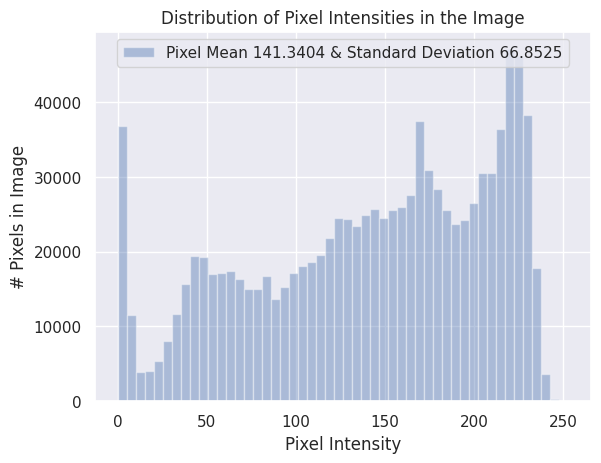

In [ ]:
sns.distplot(raw_image.ravel(),
             label=f'Pixel Mean {np.mean(raw_image):.4f} & Standard Deviation {np.std(raw_image):.4f}', kde=False)
plt.legend(loc='upper center')
plt.title('Distribution of Pixel Intensities in the Image')
plt.xlabel('Pixel Intensity')
plt.ylabel('# Pixels in Image')

### **CEVAP: AŞAĞIDA; BİR ÜST KISIMDA RASTGELE SECILMIS OLARAK GELEN 9 GORUNTUNUN HISTOGRAMINI CIZDIRDIM.**

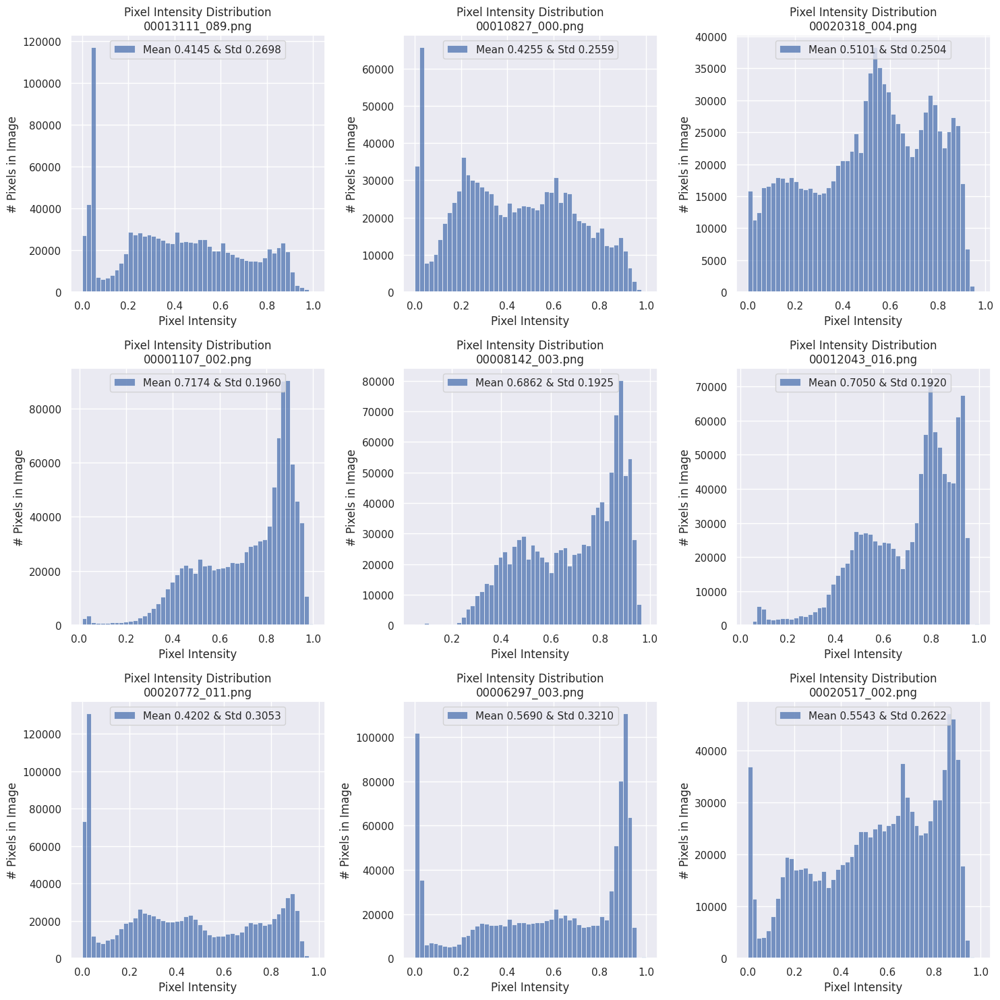

In [ ]:
# Görüntülerin bulunduğu klasörün yolu
img_dir = 'nih/images_small/'  # Görüntülerin olduğu dizin

# Yukarıda verilen rastgele görüntü dosya adları
image_list = [
    "00013111_089.png",
    "00010827_000.png",
    "00020318_004.png",
    "00001107_002.png",
    "00008142_003.png",
    "00012043_016.png",
    "00020772_011.png",
    "00006297_003.png",
    "00020517_002.png"
]

# 9 Görüntü için histogramları çizmek
plt.figure(figsize=(15, 15))  # Büyük figür boyutu
for i, img_name in enumerate(image_list):
    # Görüntü yolunu oluştur
    img_path = os.path.join(img_dir, img_name)

    # Görüntüyü yükle
    raw_image = plt.imread(img_path)

    # Histogramı çiz
    plt.subplot(3, 3, i + 1)  # 3x3 gridde yerleştir
    sns.histplot(raw_image.ravel(),
                 label=f'Mean {np.mean(raw_image):.4f} & Std {np.std(raw_image):.4f}',
                 kde=False, bins=50)
    plt.legend(loc='upper center')
    plt.title(f'Pixel Intensity Distribution\n{img_name}')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('# Pixels in Image')

plt.tight_layout()  # Alt başlıkların üst üste binmesini önler
plt.show()


**Bu 9 görüntüye ait histogram grafikleri yorumlarını şu şekilde ifade edebiliriz:**

1. 00013111_089.png :Karanlık alanlar baskın. Piksel yoğunluğu 0'da zirve yapmış. Gri tonlar da mevcut, ancak genelde karanlık tonlar hakim.
2. 00010827_000.png : Orta tonlar ağırlıklı. Piksel yoğunluğu 0.4 ile 0.6 arasında yoğunlaşmış. Dengeli bir parlaklık ve kontrast gösteriyor.
3. 00020318_004.png : Orta ve parlak tonlar hakim. Piksel yoğunluğu 0.5 ile 0.8 arasında zirve yapmış. Görüntüde parlak alanlar belirgin.
4. 00001107_002.png : Parlak alanlar baskın. Piksel yoğunluğu 0.7 ile 1.0 arasında yoğunlaşmış. Ortalama piksel değeri yüksek, görüntü genel olarak parlak.
5. 00008142_003.png : Parlak bölgeler belirgin. Piksel yoğunluğu 0.8 civarında yoğunlaşmış. Gri tonlar sınırlı, parlaklık baskın.
6. 00012043_016.png : Parlak tonlar baskın.Piksel yoğunluğu 0.6-1.0 arasında yayılmış. Görüntü daha aydınlık alanlara sahip.
7. 00020772_011.png : Karanlık alanlar baskın. Piksel yoğunluğu 0'da belirgin bir zirve yapmış. Gri tonlar da mevcut, ancak genel olarak karanlık bir görüntü.
8. 00006297_003.png : Karanlık ve parlak alanlar dengeli.Piksel yoğunluğu hem 0 hem de 1 civarında zirve yapmış. Görüntüde kontrast belirgin şekilde yüksek.
9. 00020517_002.png : Parlak alanlar ve gri tonlar baskın. Piksel yoğunluğu 0.5-0.8 arasında yoğunlaşmış. Görüntüde parlaklık dikkat çekiyor.

**Sonuç olarak:**
Görüntüler arasında karanlık ve parlak alanların farklılık gösterdiği açıkça görebiliyoruz. Bazı görüntülerin tamamen karanlık tonlara odaklanırken, bazılarının parlak tonlarda yoğunlaştığı görmekteyiz.

Histogram eşitleme ve normalizasyon yapabiliriz. Bu, modelin tüm görüntülerde benzer şekilde performans göstermesini bize sağlayabilir.
Kontrast ve parlaklık farklarını dengelemek için veri artırma yöntemleri kullanabiliriz. Görüntüler arasında kontrast farklılıkları bulunuyor. Bu, veri çeşitliliğini artırsa da modelin performansı için dikkat etmemiz gereken bir durum. Çalışmamızda bunu göz önünde bulundurmalıyız.

# 3. Görüntü İşleme ve İyileştirme
**1-Kontrast Germe (Stretching)**

o	Minimum ve maksimum piksel değerlerini kullanarak kontrast germe işlemi yapın.

**2-Histogram Eşitleme (Equalization)**

o	Kontrast germe işlemi sonrası histogram eşitleme uygulayarak kontrastı artırın.

**3-Gamma Düzeltme**

o	Gamma düzeltme yöntemi ile görüntünün parlaklığını ayarlayın.


### **GORUNTULERE CONTRAST STRECTCHING YAPINIZ, CONTRAST STRECTCHING GORUNTULERINE GAMMA TRANSFORMATIONU UYGULAYINIZ. ORNEK OLARAK BIR GORUNTU ICIN VERILMISTIR**

In [ ]:
pip install numpy


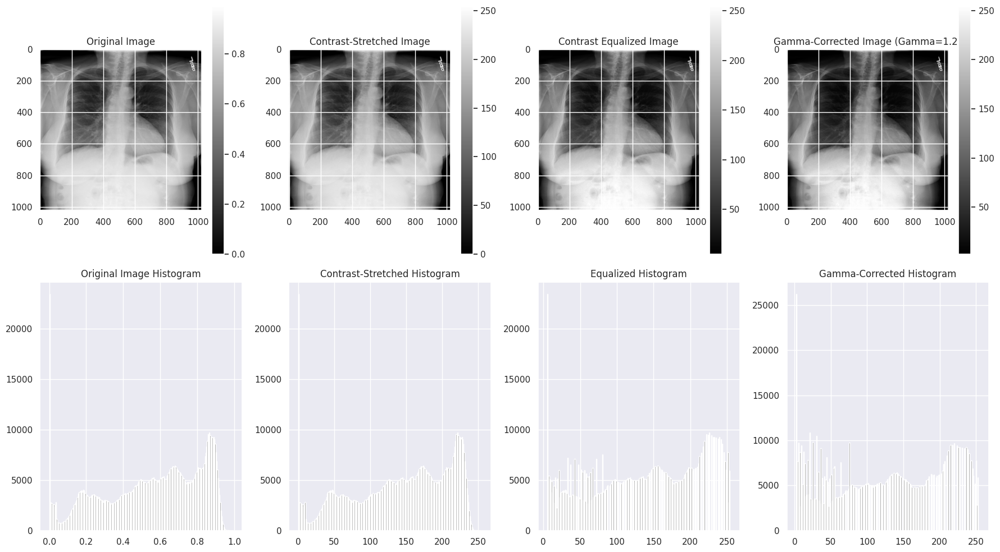

In [ ]:
from skimage import exposure

# Calculate minimum and maximum for contrast stretching
min_val, max_val = raw_image.min(), raw_image.max()

# Step 1: Apply contrast stretching
min_val, max_val = raw_image.min(), raw_image.max()
contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize to [0, 1]
contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # Scale to [0, 255] for visualization

# Step 2: Apply histogram equalization after contrast stretching
# Step 2: Apply histogram equalization using skimage
equalized_image = exposure.equalize_hist(contrast_stretched)  # Returns values in [0, 1]
equalized_image = (equalized_image * 255).astype(np.uint8)    # Scale to [0, 255]


# Step 3: Apply gamma correction on the equalized image
gamma = 1.2  # Adjust gamma value as needed
gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
gamma_corrected = gamma_corrected.astype(np.uint8)

# Plot original image and histogram
plt.figure(figsize=(18, 10))
plt.subplot(2, 4, 1)
plt.imshow(raw_image, cmap='gray')
plt.title('Original Image')
plt.colorbar()
plt.subplot(2, 4, 5)
plt.hist(raw_image.ravel(), bins=256, color='gray')
plt.title("Original Image Histogram")

# Plot contrast-stretched image and histogram
plt.subplot(2, 4, 2)
plt.imshow(contrast_stretched, cmap='gray')
plt.title('Contrast-Stretched Image')
plt.colorbar()
plt.subplot(2, 4, 6)
plt.hist(contrast_stretched.ravel(), bins=256, color='gray')
plt.title("Contrast-Stretched Histogram")

# Plot contrast-equalized image and histogram
plt.subplot(2, 4, 3)
plt.imshow(equalized_image, cmap='gray')
plt.title('Contrast Equalized Image')
plt.colorbar()
plt.subplot(2, 4, 7)
plt.hist(equalized_image.ravel(), bins=256, color='gray')
plt.title("Equalized Histogram")

# Plot gamma-corrected image and histogram
plt.subplot(2, 4, 4)
plt.imshow(gamma_corrected, cmap='gray')
plt.title(f'Gamma-Corrected Image (Gamma={gamma})')
plt.colorbar()
plt.subplot(2, 4, 8)
plt.hist(gamma_corrected.ravel(), bins=256, color='gray')
plt.title("Gamma-Corrected Histogram")

plt.tight_layout()
plt.show()

<ipython-input-21-cb9e466053e8>:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(gamma_corrected.ravel(),


Text(0, 0.5, '# Pixels in Image')

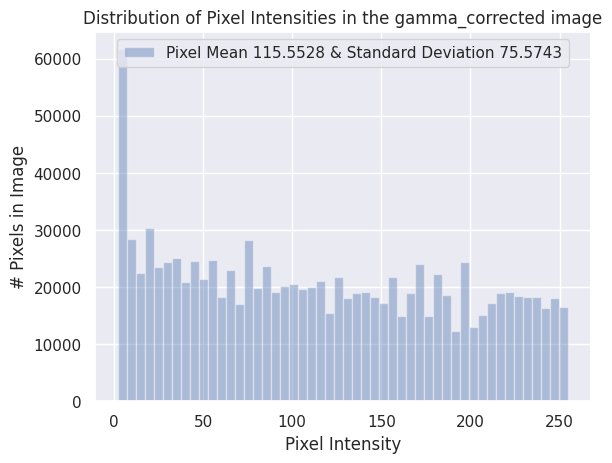

In [ ]:
# Plot a histogram of the distribution of the pixels
sns.distplot(gamma_corrected.ravel(),
             label=f'Pixel Mean {np.mean(gamma_corrected):.4f} & Standard Deviation {np.std(gamma_corrected):.4f}', kde=False)
plt.legend(loc='upper center')
plt.title('Distribution of Pixel Intensities in the gamma_corrected image')
plt.xlabel('Pixel Intensity')
plt.ylabel('# Pixels in Image')

### **CEVAP**: **YUKARIDA BELİRLEDİĞİM 9 GÖRÜNTÜNÜN HEPSİNE CONTRAST STRECTCHING YAPTIM. CONTRAST STRECTCHING GORUNTULERINE GAMMA TRANSFORMATIONU UYGULADIM.**

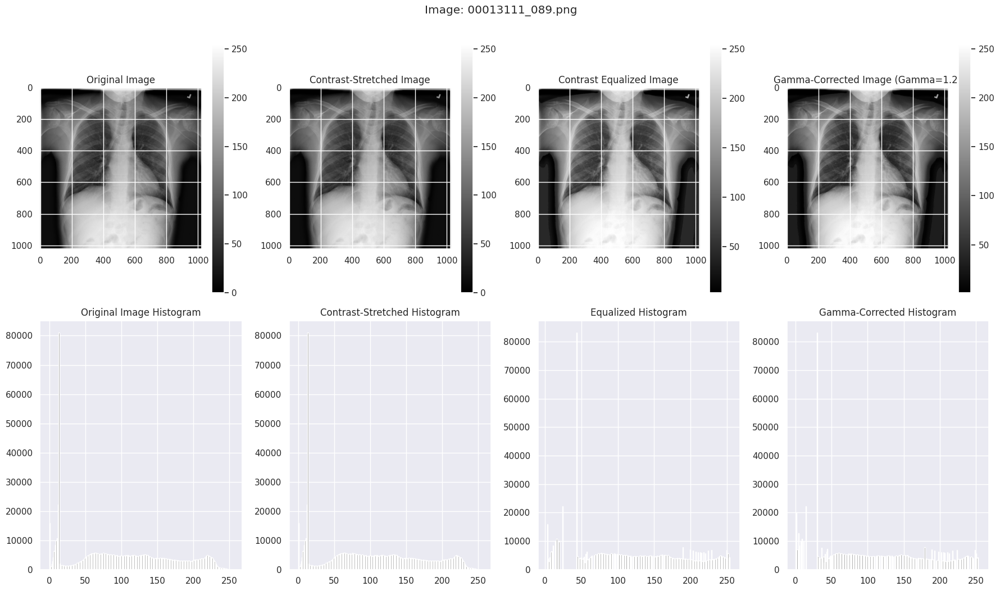

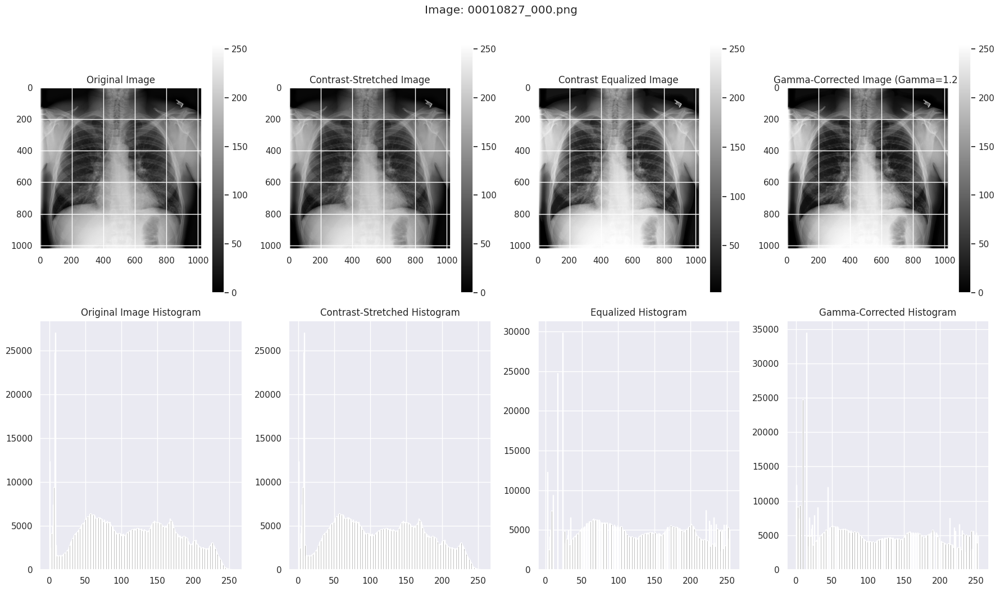

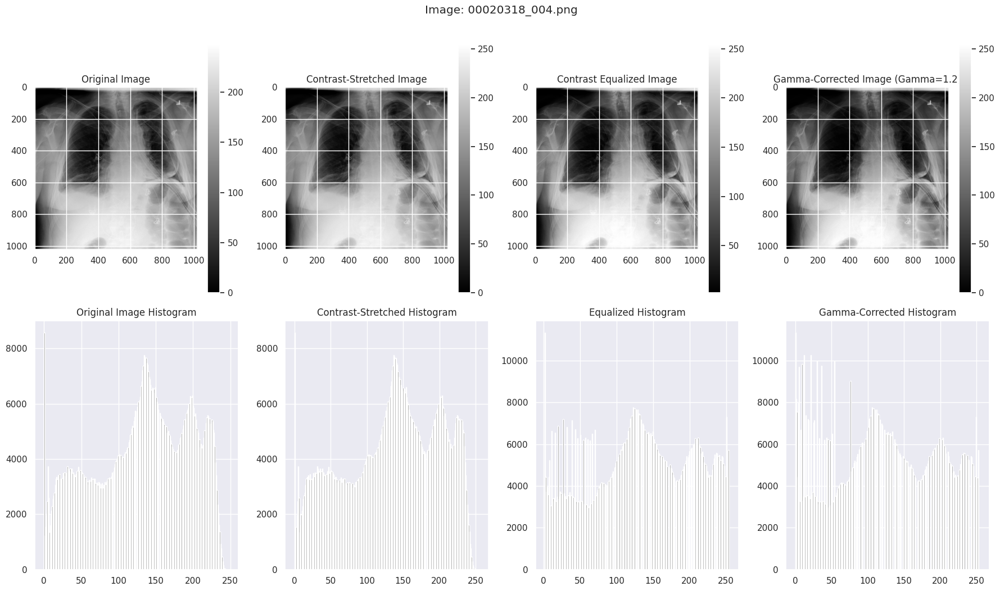

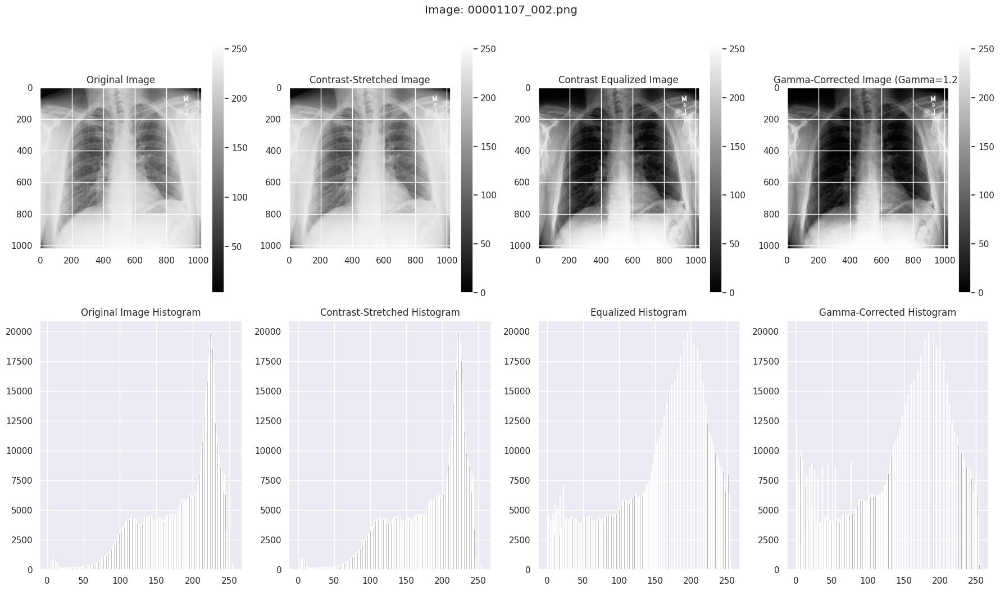

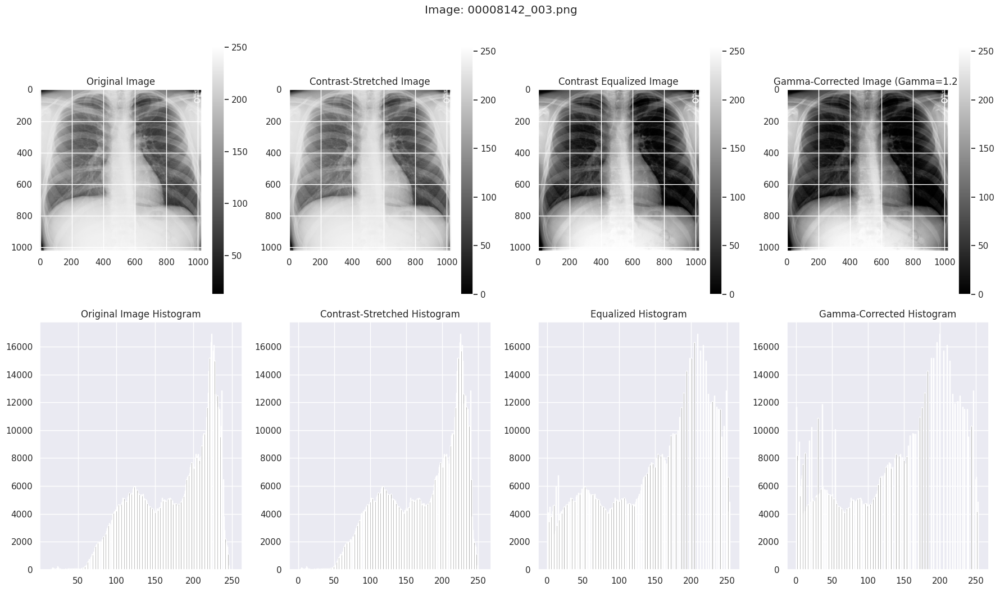

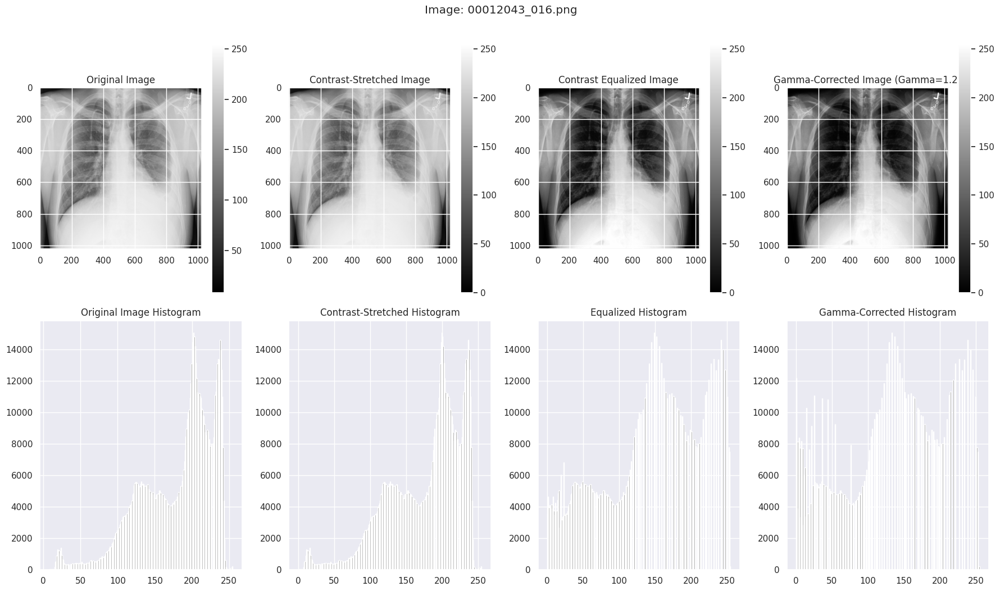

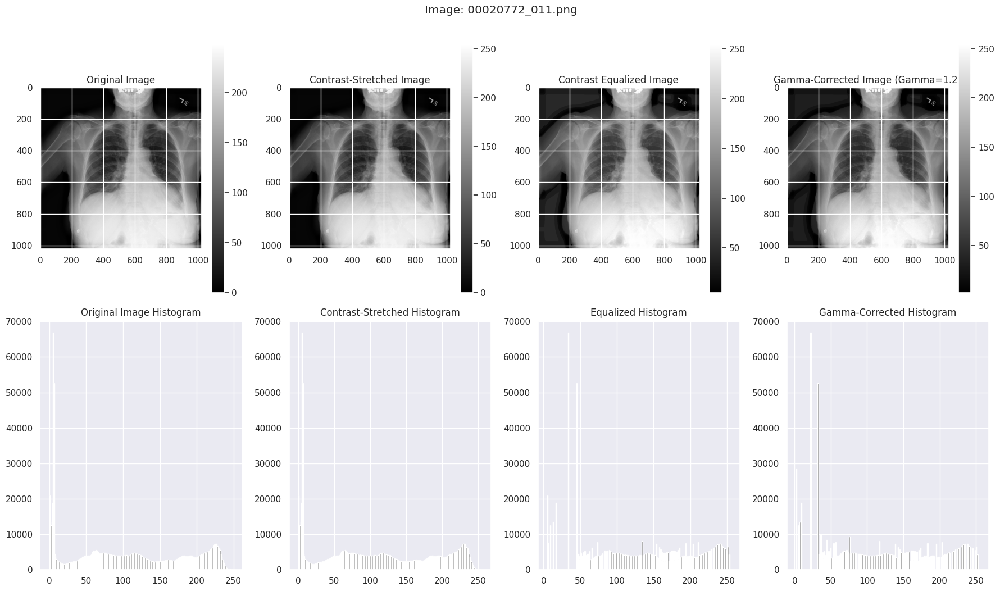

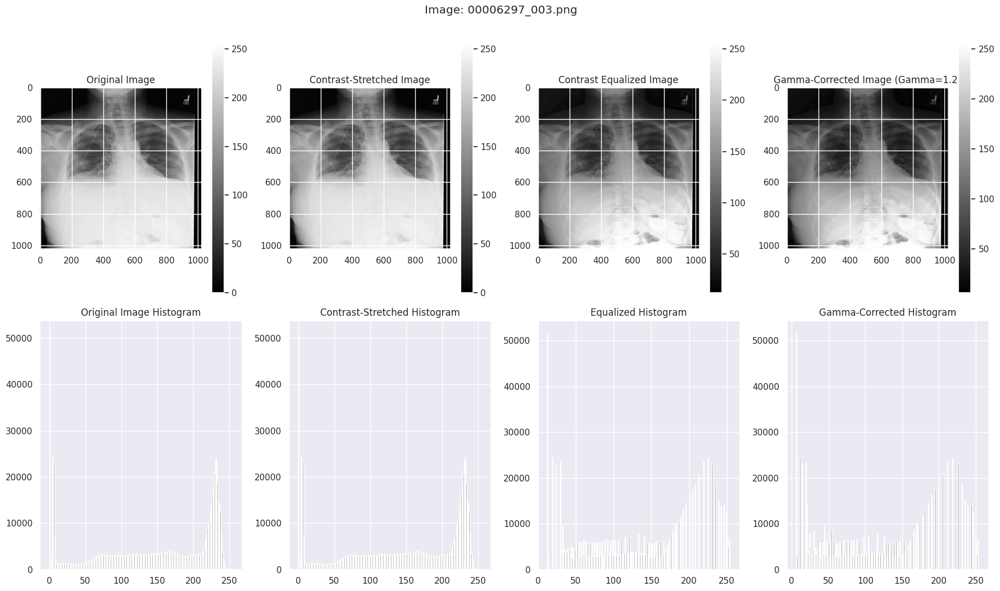

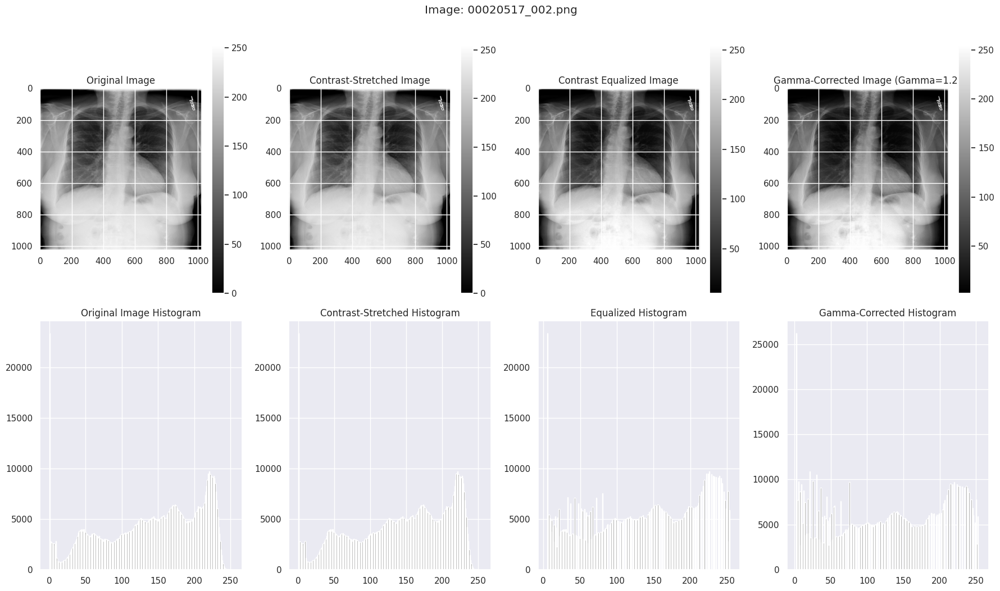

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure
from skimage.io import imread

# Görüntülerin bulunduğu klasörün yolu
img_dir = 'nih/images_small/'  # Görüntülerin olduğu dizin

# Yukarıda rastgele olarak seçtiğimiz görüntü dosya adları ve işlemlerimiz:
image_list = [
    "00013111_089.png",
    "00010827_000.png",
    "00020318_004.png",
    "00001107_002.png",
    "00008142_003.png",
    "00012043_016.png",
    "00020772_011.png",
    "00006297_003.png",
    "00020517_002.png"
]

# Gamma değeri
gamma = 1.2

# İşlemleri her bir görüntü için uygula
for img_name in image_list:
    # Görüntü yolunu oluştur ve yükle
    img_path = os.path.join(img_dir, img_name)
    raw_image = imread(img_path)

    # Step 1: Apply contrast stretching
    min_val, max_val = raw_image.min(), raw_image.max()
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize to [0, 1]
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # Scale to [0, 255]

    # Step 2: Apply histogram equalization
    equalized_image = exposure.equalize_hist(contrast_stretched)  # Normalize to [0, 1]
    equalized_image = (equalized_image * 255).astype(np.uint8)    # Scale to [0, 255]

    # Step 3: Apply gamma correction
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Plot results for each image
    plt.figure(figsize=(18, 10))

    # Plot original image and histogram
    plt.subplot(2, 4, 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title('Original Image')
    plt.colorbar()
    plt.subplot(2, 4, 5)
    plt.hist(raw_image.ravel(), bins=256, color='gray')
    plt.title("Original Image Histogram")

    # Plot contrast-stretched image and histogram
    plt.subplot(2, 4, 2)
    plt.imshow(contrast_stretched, cmap='gray')
    plt.title('Contrast-Stretched Image')
    plt.colorbar()
    plt.subplot(2, 4, 6)
    plt.hist(contrast_stretched.ravel(), bins=256, color='gray')
    plt.title("Contrast-Stretched Histogram")

    # Plot contrast-equalized image and histogram
    plt.subplot(2, 4, 3)
    plt.imshow(equalized_image, cmap='gray')
    plt.title('Contrast Equalized Image')
    plt.colorbar()
    plt.subplot(2, 4, 7)
    plt.hist(equalized_image.ravel(), bins=256, color='gray')
    plt.title("Equalized Histogram")

    # Plot gamma-corrected image and histogram
    plt.subplot(2, 4, 4)
    plt.imshow(gamma_corrected, cmap='gray')
    plt.title(f'Gamma-Corrected Image (Gamma={gamma})')
    plt.colorbar()
    plt.subplot(2, 4, 8)
    plt.hist(gamma_corrected.ravel(), bins=256, color='gray')
    plt.title("Gamma-Corrected Histogram")

    plt.tight_layout()
    plt.suptitle(f"Image: {img_name}", y=1.05)
    plt.show()


**HER GÖRÜNTÜ İÇİN GRAFİK YORUMLARI:**

**Görüntü 1: 00001107_002**: Orijinal Görüntü: Düşük kontrastlı, detaylar silik. Histogram dar bir aralıkta yoğunlaşmış.
1.	Contrast Stretching: Kontrast artırılarak karanlık ve parlak alanlar netleşmiş. Histogram tüm yoğunluk aralığına yayılmış.
2.	Histogram Equalization: Parlaklık dengelenmiş, karanlık bölgeler görünür hale gelmiş. Detayların belirginliği artmış.
3.	Gamma Correction: Parlaklık artırılmış, parlak alanlar daha fazla vurgulanmış. Görüntü daha net ve parlak hale gelmiş.
**Görüntü 2: 00006297_003:**
1.	Orijinal Görüntü: Kontrast düşük, detaylar belirsiz.
2.	Contrast Stretching: Kontrast artırılmış, koyu ve açık tonlar daha net.
3.	Histogram Equalization: Parlaklık dengelenmiş, karanlık bölgeler belirgin hale gelmiş.
4.	Gamma Correction: Parlaklık artırılmış, detaylar öne çıkmış.

**Görüntü 3: 00008142_003 :**
1.	Orijinal Görüntü: Parlaklık orta düzeyde, detaylar belirgin ama kontrast sınırlı.
2.	Contrast Stretching: Kontrast artırılmış, koyu ve parlak tonlar daha net hale gelmiş.
3.	Histogram Equalization: Parlaklık daha dengeli dağıtılmış, detaylar öne çıkmış.
4.	Gamma Correction: Parlaklık artırılarak parlak bölgeler vurgulanmış, daha net bir görüntü sağlanmış.

**Görüntü 4: 00010827_000 :**
1.	Orijinal Görüntü: Kontrast düşük, parlak ve koyu alanlar arasında ayrım sınırlı.
2.	Contrast Stretching: Görüntü kontrastı artırılmış, detaylar daha belirgin hale gelmiş.
3.	Histogram Equalization: Parlaklık eşitlenmiş, karanlık ve parlak alanlar dengelenmiş.
4.	Gamma Correction: Parlaklık artırılmış, parlak bölgeler daha vurgulu hale getirilmiş.
**Görüntü 5: 00012043_016 :**
1.	Orijinal Görüntü: Parlaklık orta düzeyde, detaylar belirgin ancak kontrast sınırlı.
2.	Contrast Stretching: Kontrast artırılarak koyu ve parlak tonlar daha net hale gelmiş.
3.	Histogram Equalization: Parlaklık dengelenmiş, koyu bölgelerdeki detaylar öne çıkmış.
4.	Gamma Correction: Parlaklık artırılmış, parlak alanlar vurgulanmış ve görüntü daha dikkat çekici hale getirilmiş.
**Görüntü 6: 00013111_089:**
1.	Orijinal Görüntü: Kontrast düşük, parlaklık düzeyi sınırlı ve detaylar belirgin değil.
2.	Contrast Stretching: Kontrast artırılmış, karanlık ve parlak bölgeler daha net hale gelmiş.
3.	Histogram Equalization: Parlaklık dağılımı dengelenmiş, detaylar daha görünür olmuş.
4.	Gamma Correction: Parlaklık artırılmış, parlak bölgeler öne çıkmış ve görüntü daha net hale gelmiş.
**Görüntü 7: 00020318_004 :**
1.	Orijinal Görüntü: Orta düzey parlaklık, ancak kontrast düşük ve detaylar belirgin değil.
2.	Contrast Stretching: Kontrast artırılmış, koyu ve açık bölgeler daha net hale gelmiş.
3.	Histogram Equalization: Parlaklık dengelenmiş, detaylar öne çıkarılmış.
4.	Gamma Correction: Parlaklık artırılarak, parlak bölgeler daha vurgulu hale gelmiş.
**Görüntü 8: 00020517_002 :**
1.	Orijinal Görüntü: Parlaklık ve kontrast sınırlı, detaylar yeterince belirgin değil.
2.	Contrast Stretching: Kontrast artırılarak karanlık ve parlak bölgeler netleşmiş.
3.	Histogram Equalization: Parlaklık dengelenmiş, detaylar daha görünür hale gelmiş.
4.	Gamma Correction: Parlaklık artırılmış, özellikle parlak bölgeler vurgulanmış.
**Görüntü 9: 00020772_011 :**
1.	Orijinal Görüntü: Düşük kontrast, parlak ve karanlık alanlar arasında ayrım sınırlı.
2.	Contrast Stretching: Kontrast artırılmış, detaylar daha net hale gelmiş.
3.	Histogram Equalization: Parlaklık eşitlenmiş, koyu bölgeler daha görünür olmuş.
4.	Gamma Correction: Parlaklık artırılarak parlak alanlar daha vurgulu hale getirilmiş.
**Sonuç olarak,** bu işlemleri yaptığımızda görüntünün kontrastını ve parlaklığını iyileştirerek klinik olarak analiz için daha kullanışlı hale getirdiğini görüyoruz. Böylelikle görsel detayları belirginliği artırılarak analiz için daha uygun hale getirilmiştir.






## **Aşağıda bu 9 görselin her biri için gamma düzeltmesi uygulanmış piksel yoğunluk histogramlarını çizdirdim:**

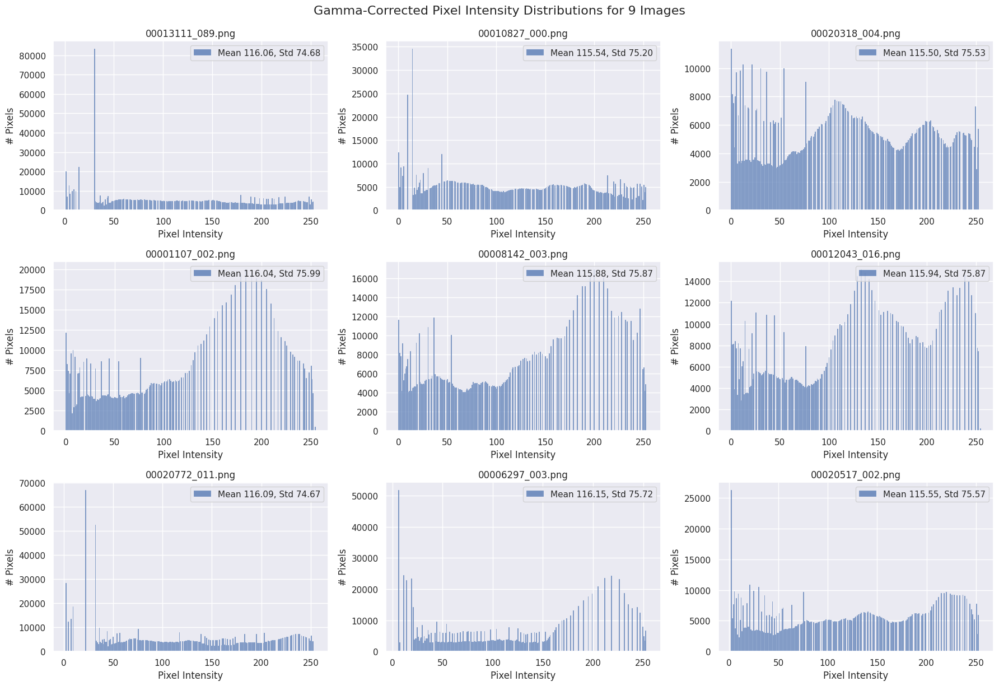

In [ ]:
# Görüntülerin bulunduğu klasörün yolu
img_dir = 'nih/images_small/'  # Görüntülerin olduğu dizin

# Görüntü dosya adları
image_list = [
    "00013111_089.png",
    "00010827_000.png",
    "00020318_004.png",
    "00001107_002.png",
    "00008142_003.png",
    "00012043_016.png",
    "00020772_011.png",
    "00006297_003.png",
    "00020517_002.png"
]

# Gamma değeri
gamma = 1.2

# 3x3 grid üzerinde histogramları çizmek için ayarlar
fig, axes = plt.subplots(3, 3, figsize=(18, 12))  # 3x3 grid yapısı
axes = axes.ravel()  # Alt grafiklere erişimi kolaylaştırmak için düzleştir

for i, img_name in enumerate(image_list):
    # Görüntü yolunu oluştur ve yükle
    img_path = os.path.join(img_dir, img_name)
    raw_image = imread(img_path)

    # Step 1: Apply contrast stretching
    min_val, max_val = raw_image.min(), raw_image.max()
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize to [0, 1]
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # Scale to [0, 255]

    # Step 2: Apply histogram equalization
    equalized_image = exposure.equalize_hist(contrast_stretched)  # Normalize to [0, 1]
    equalized_image = (equalized_image * 255).astype(np.uint8)    # Scale to [0, 255]

    # Step 3: Apply gamma correction
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Her bir görüntü için histogram çizimi
    sns.histplot(
        gamma_corrected.ravel(),
        bins=256,
        kde=False,
        ax=axes[i],
        label=f'Mean {np.mean(gamma_corrected):.2f}, Std {np.std(gamma_corrected):.2f}'
    )
    axes[i].legend(loc='upper right')
    axes[i].set_title(f'{img_name}')
    axes[i].set_xlabel('Pixel Intensity')
    axes[i].set_ylabel('# Pixels')

# Layout ayarları
plt.tight_layout()
plt.suptitle("Gamma-Corrected Pixel Intensity Distributions for 9 Images", y=1.02, fontsize=16)
plt.show()


**Görsellerin Histogram Yorumları:**
1.	00013111_089.png
o	Piksel yoğunlukları daha çok düşük seviyelerde (0-50) yoğunlaşmış.
o	Ortalama yoğunluk 116.06 ve standart sapma 74.68. Görüntüde daha karanlık alanlar baskın.
2.	00010827_000.png
o	Düşük yoğunluk (0-50) ağırlıklı, ancak dağılım orta ve yüksek yoğunluklara da yayılmış.
o	Ortalama yoğunluk 115.54 ve standart sapma 75.20. Kontrast artırılmış.
3.	00020318_004.png
o	Geniş bir yoğunluk dağılımı gözlemleniyor. Orta ve yüksek piksel yoğunlukları belirgin.
o	Ortalama yoğunluk 115.50 ve standart sapma 75.53. Görüntü dengeli aydınlık alanlar içeriyor.
4.	00001107_002.png
o	Orta piksel yoğunlukları (100-200) yoğunlaşmış, düşük yoğunluklar daha az temsil edilmiş.
o	Ortalama yoğunluk 116.04 ve standart sapma 75.99. Orta kontrastlı.
5.	00008142_003.png
o	Piksel yoğunlukları 50-200 arasında yayılmış, yüksek yoğunluklar (200-255) belirgin.
o	Ortalama yoğunluk 115.88 ve standart sapma 75.87. Daha parlak görüntü.
6.	00012043_016.png
o	Yoğunluklar geniş bir aralığa yayılmış, yüksek yoğunluklar baskın.
o	Ortalama yoğunluk 115.94 ve standart sapma 75.87. Görüntüde aydınlık alanlar hakim.
7.	00020772_011.png
o	Düşük piksel yoğunlukları (0-50) dikkat çekici, orta yoğunluklar az temsil edilmiş.
o	Ortalama yoğunluk 116.09 ve standart sapma 74.67. Karanlık alanlar ağırlıkta.
8.	00006297_003.png
o	Piksel yoğunlukları dengeli bir şekilde 50-200 arasında yayılmış, yüksek yoğunluklar da mevcut.
o	Ortalama yoğunluk 116.15 ve standart sapma 75.72. Dengeli bir parlaklık var.
9.	00020517_002.png
o	Orta piksel yoğunlukları (100-200) öne çıkmış. Yüksek yoğunluklar da eşit şekilde temsil edilmiş.
o	Ortalama yoğunluk 115.55 ve standart sapma 75.57. Dengeli bir histogram.

**Sonuç olarak:** Görüntüler genel olarak kontrast artırılmış ve piksel yoğunlukları geniş bir aralığa yayılmış. Gamma düzeltmesi, karanlık ve aydınlık alanlar arasındaki dengeyi sağlamış. Ortalama yoğunluklar 115-116 arasında, standart sapmalar ise 74-76 arasında sabit bir dağılım göstermektedir. Görüntüler arasında parlaklık ve kontrast açısından bazı farklılıklar olsa da genel histogram dağılımları benzer bir yapıya sahiptir.

### 4. Gürültü Azaltma :
  
   1. Median ve Gaussian Blur Uygulama: Gamma düzeltilmiş görüntüye median ve gaussian blur uygulayın ve sonuçları karşılaştırın.


## **TUM GORUNTULERE EMDIAN VE GAUSSIAN BLUR UYGULAYIN**

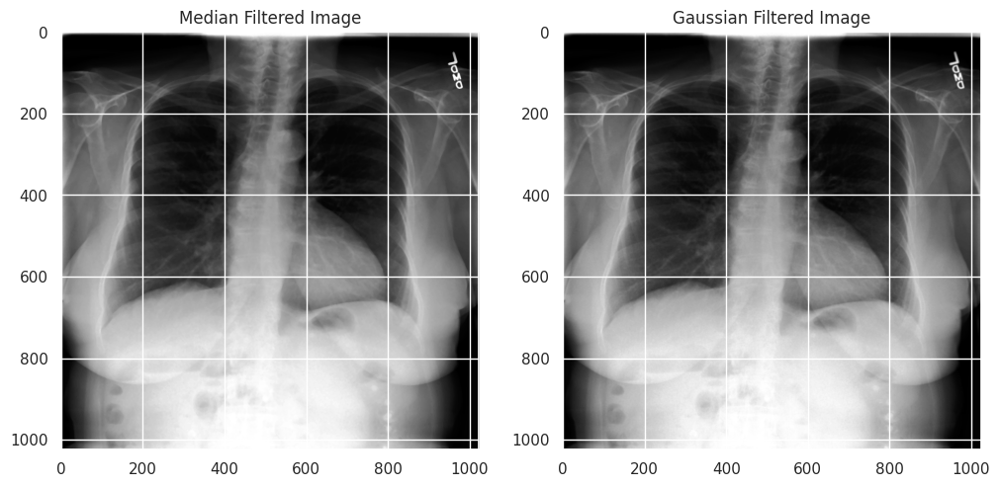

In [ ]:
import cv2  # opencv for python package

# Apply Median Filtering
median_filtered = cv2.medianBlur(gamma_corrected, 5)

# Apply Gaussian Blur
gaussian_filtered = cv2.GaussianBlur(gamma_corrected, (5, 5), 0)

# Display Results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1), plt.imshow(median_filtered, cmap='gray'), plt.title("Median Filtered Image")
plt.subplot(1, 2, 2), plt.imshow(gaussian_filtered, cmap='gray'), plt.title("Gaussian Filtered Image")
plt.show()


### **CEVAP: AŞAĞIDA 9 GÖRÜNTÜYE EMDIAN VE GAUSSIAN BLUR UYGULADIM:**

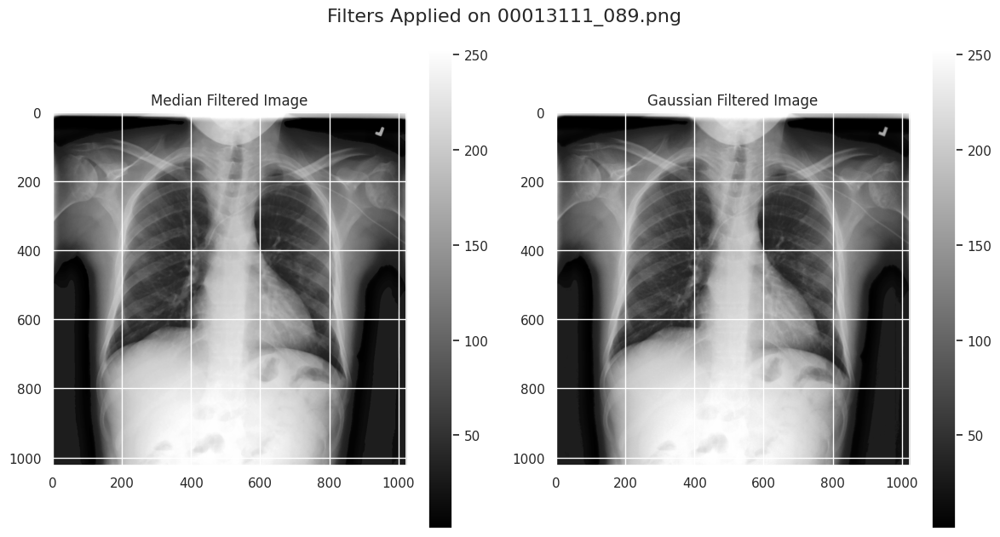

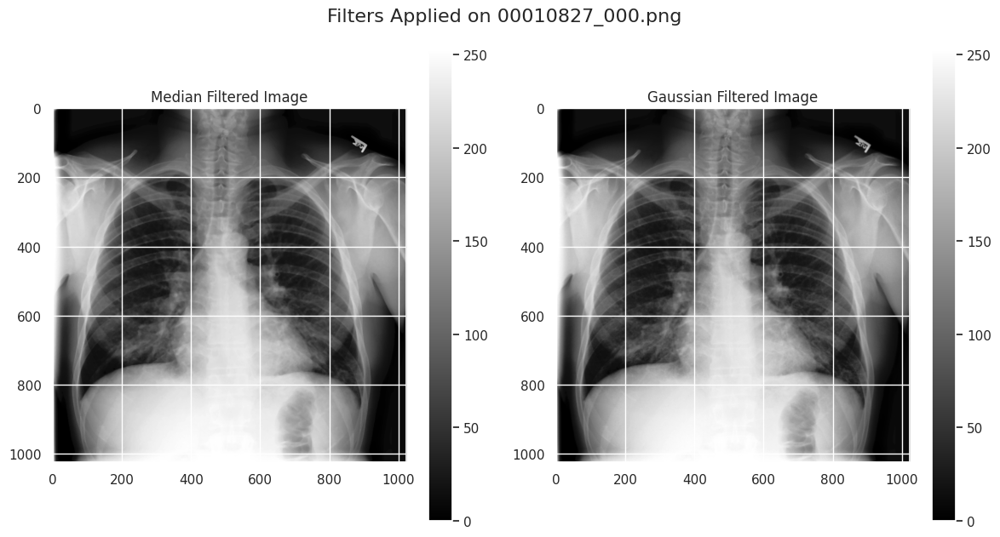

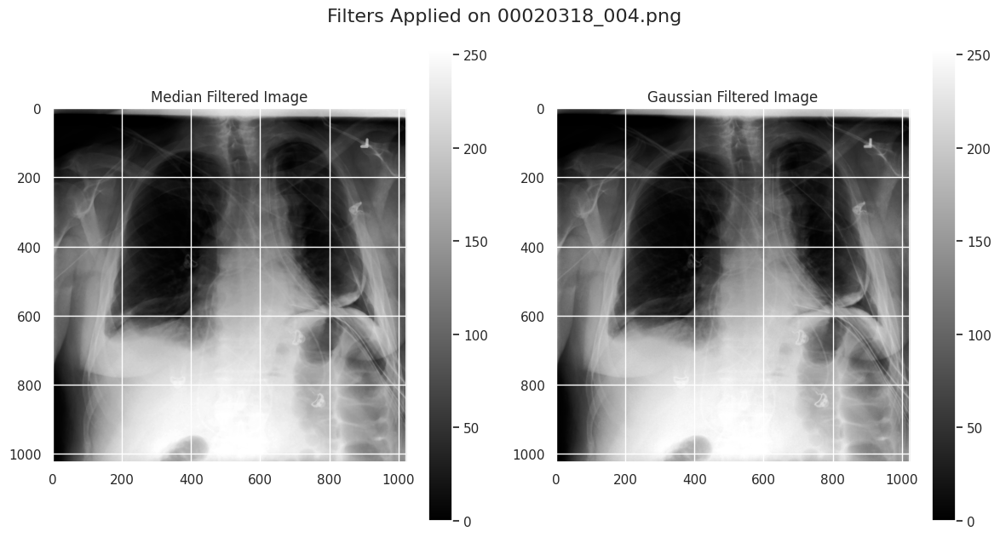

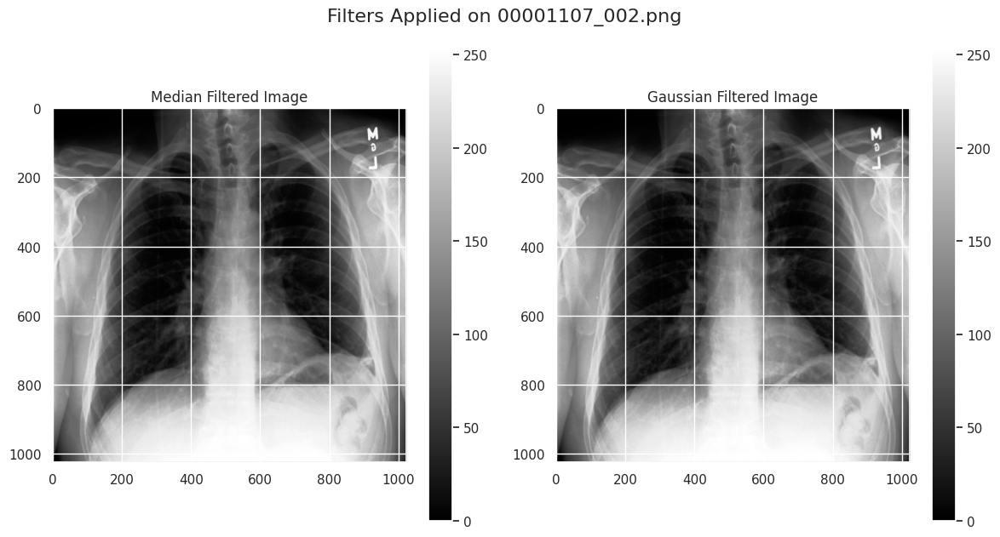

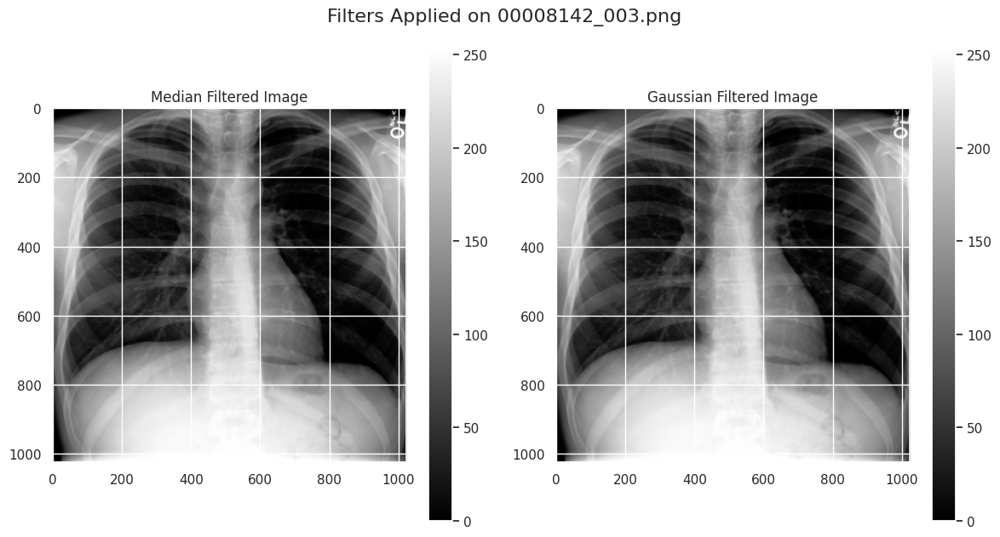

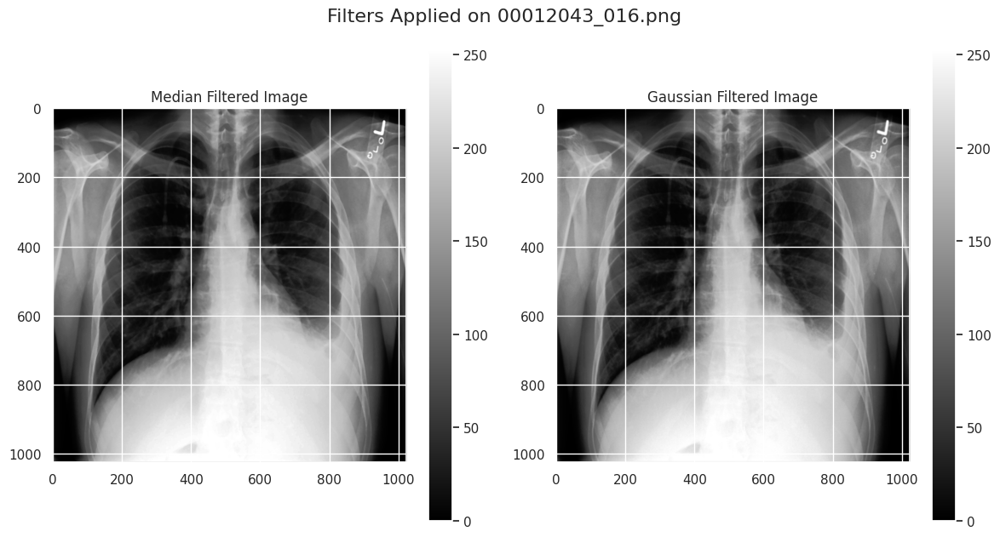

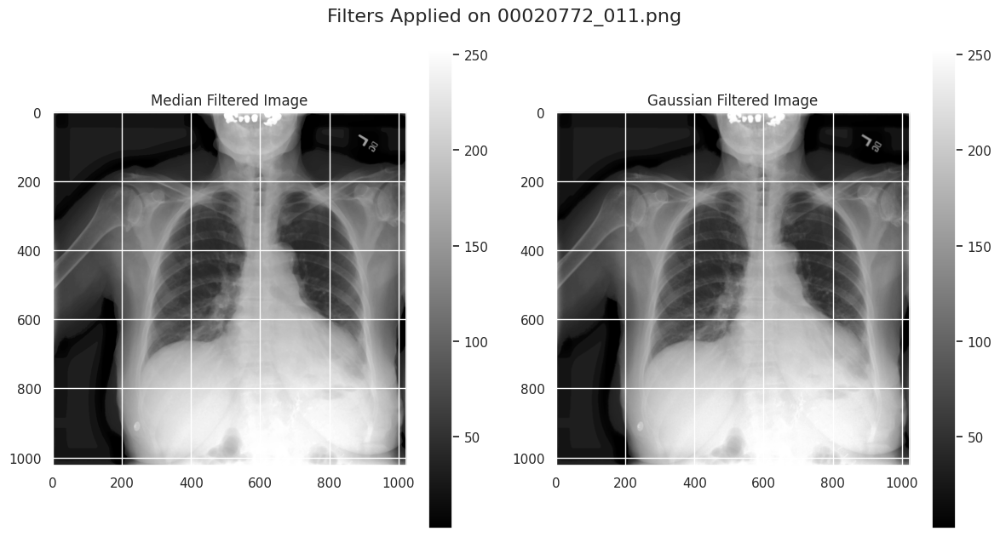

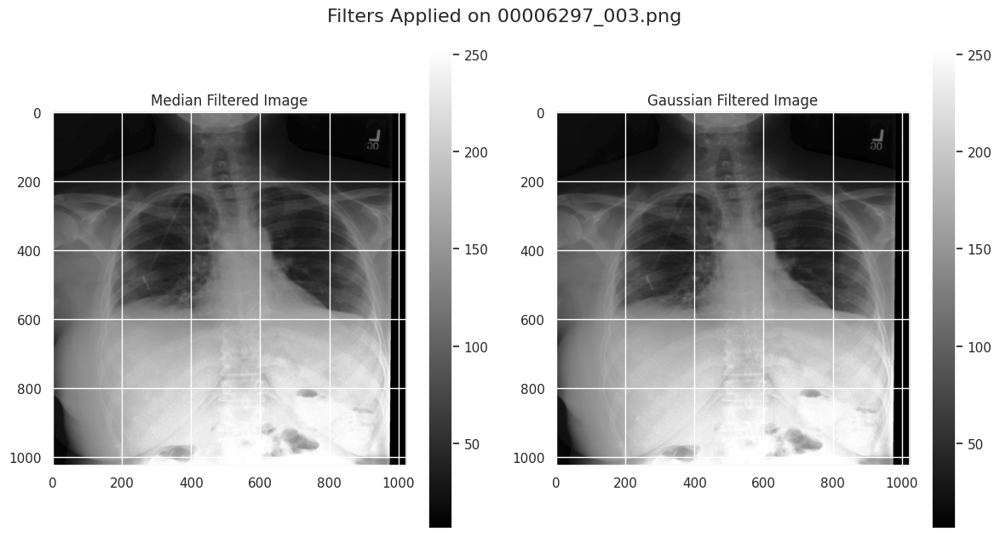

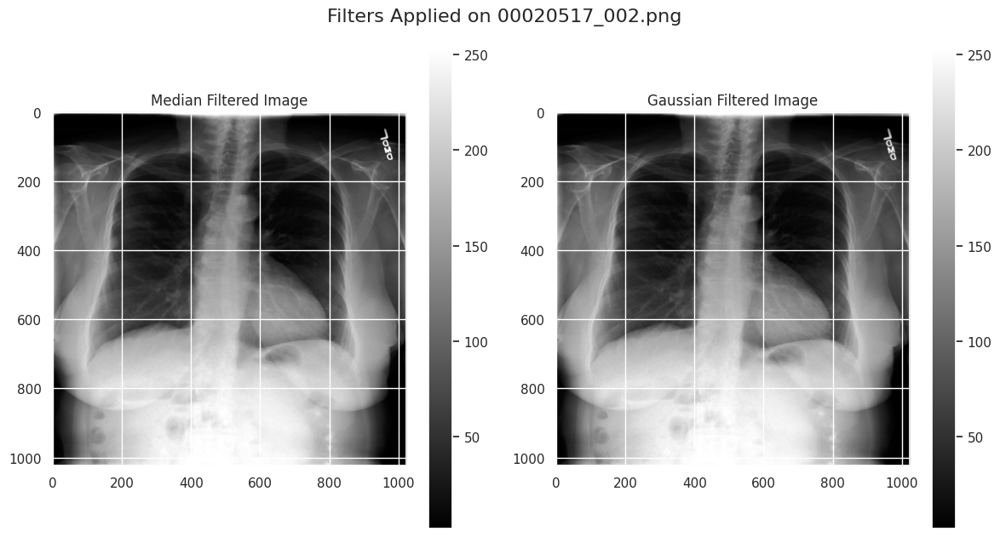

In [ ]:
import cv2  # opencv for python package

# Gamma değeri
gamma = 1.2

# İşlemleri her bir görüntü için uygula
for img_name in image_list:
    # Görüntü yolunu oluştur ve yükle
    img_path = os.path.join(img_dir, img_name)
    raw_image = imread(img_path)

    # Step 1: Apply contrast stretching
    min_val, max_val = raw_image.min(), raw_image.max()
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize to [0, 1]
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # Scale to [0, 255]

    # Step 2: Apply histogram equalization
    equalized_image = exposure.equalize_hist(contrast_stretched)  # Normalize to [0, 1]
    equalized_image = (equalized_image * 255).astype(np.uint8)    # Scale to [0, 255]

    # Step 3: Apply gamma correction
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Apply Median Filtering
    median_filtered = cv2.medianBlur(gamma_corrected, 5)

    # Apply Gaussian Blur
    gaussian_filtered = cv2.GaussianBlur(gamma_corrected, (5, 5), 0)

    # Plot Results
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(median_filtered, cmap='gray')
    plt.title("Median Filtered Image")
    plt.colorbar()

    plt.subplot(1, 2, 2)
    plt.imshow(gaussian_filtered, cmap='gray')
    plt.title("Gaussian Filtered Image")
    plt.colorbar()

    plt.tight_layout()
    plt.suptitle(f"Filters Applied on {img_name}", y=1.05, fontsize=16)
    plt.show()

**Median Filtered Image:** Median filtresi, gürültüyü azaltmak için kullanılır ve özellikle tuz ve karabiber gürültüsünü temizlemede etkilidir.

**Gaussian Filtered Image:** Gaussian filtresi, görüntüyü yumuşatmak ve genel bir bulanıklaştırma etkisi yaratmak için kullanılır.

**GÖRÜNTÜLERİN YORUMU:**

Görsellerde Median filtre, ince detayları (ör, akciğer yapıları) daha iyi koruyarak netlik sağlamış ve gürültüyü başarıyla azaltmıştır. Gaussian filtre ise genel bir yumuşatma ve pürüzsüzlük sağlamış ancak bazı detayları bulanıklaştırmıştır. Medikal analiz için Median filtre daha uygun görünmektedir, çünkü yapıları koruma konusunda daha etkili olmuştur.


### 5. Döndürme ve Ayna Çevirme (Flipping)
  1.	Rastgele Açılarla Döndürme:	Görüntüyü 0 ile 10 derece arasında rastgele bir açıda döndürün.
  2.	Ayna Çevirme: Görüntüyü yatay olarak çevirin ve sonucu görselleştirin.


### **DERECESI RASTGELE 0 ILA 10 ARASINDA OLACAK SEKILDE ROTATION UYGULAYIN GORUNTUYE, FLIPPING UYGULAYIN**    

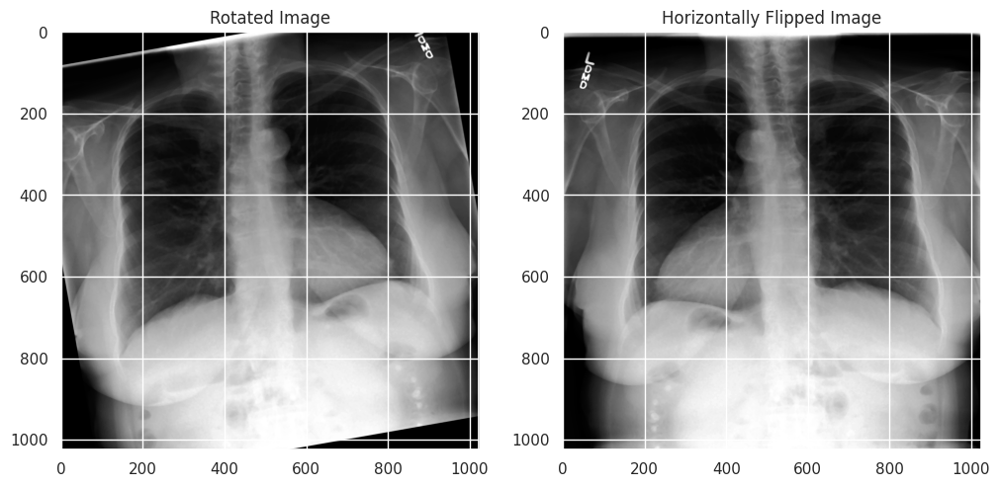

In [ ]:
# Example: Rotate the image by 10 degrees
center = (median_filtered.shape[1] // 2, median_filtered.shape[0] // 2)
rotation_matrix = cv2.getRotationMatrix2D(center, angle=10, scale=1.0)
rotated_image = cv2.warpAffine(median_filtered, rotation_matrix, (median_filtered.shape[1], median_filtered.shape[0]))

# Horizontal Flip
flipped_horizontal = cv2.flip(median_filtered, 1)

# Display Results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1), plt.imshow(rotated_image, cmap='gray'), plt.title("Rotated Image")
plt.subplot(1, 2, 2), plt.imshow(flipped_horizontal, cmap='gray'), plt.title("Horizontally Flipped Image")
plt.show()


### **CEVAP: DERECESI RASTGELE 0 ILA 10 ARASINDA OLACAK SEKILDE 9 GÖRÜNTÜYE DE ROTATION UYGULADIM, FLIPPING UYGULADIM.**

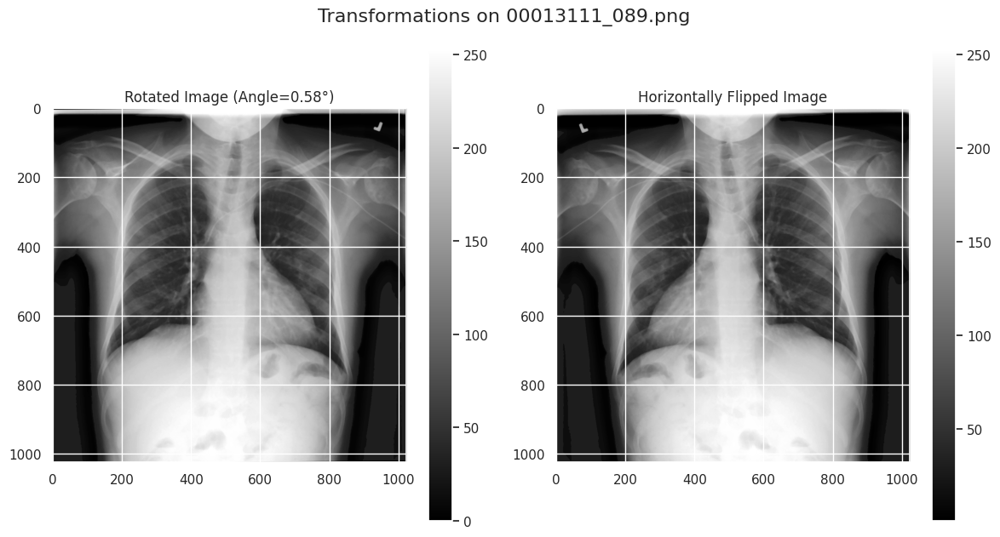

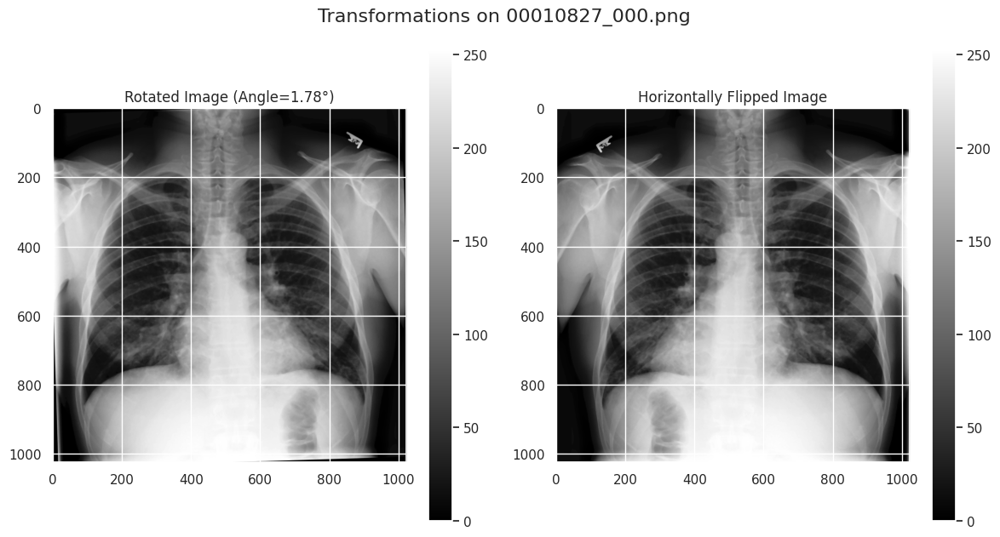

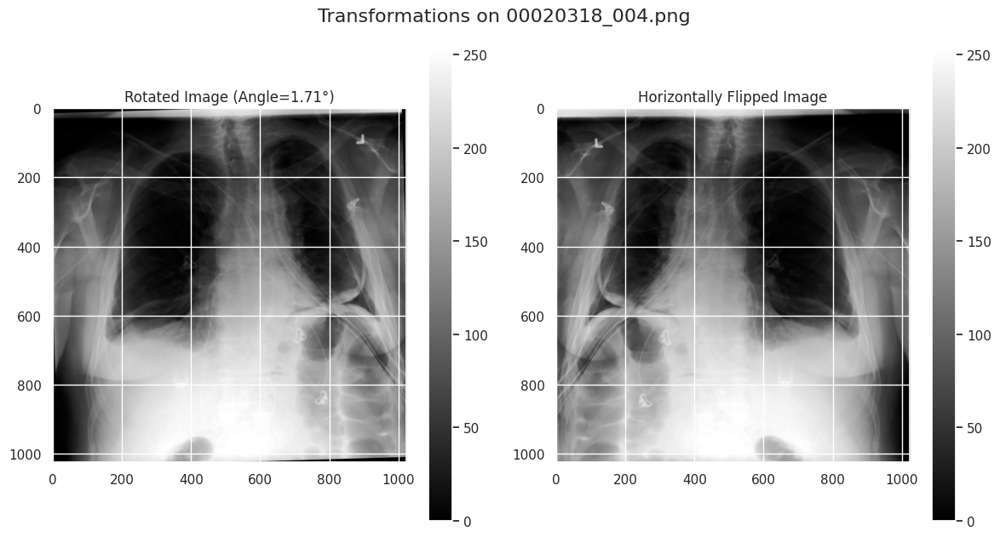

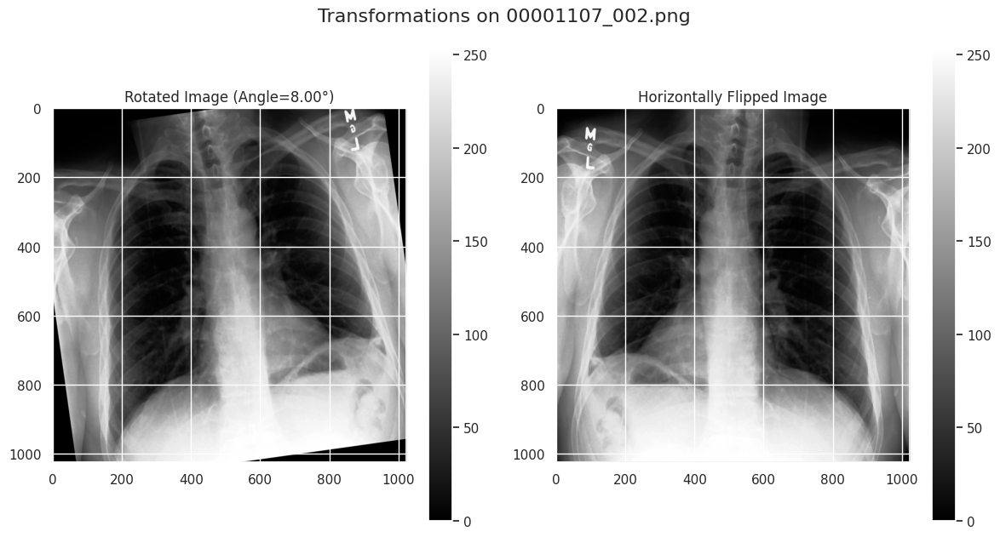

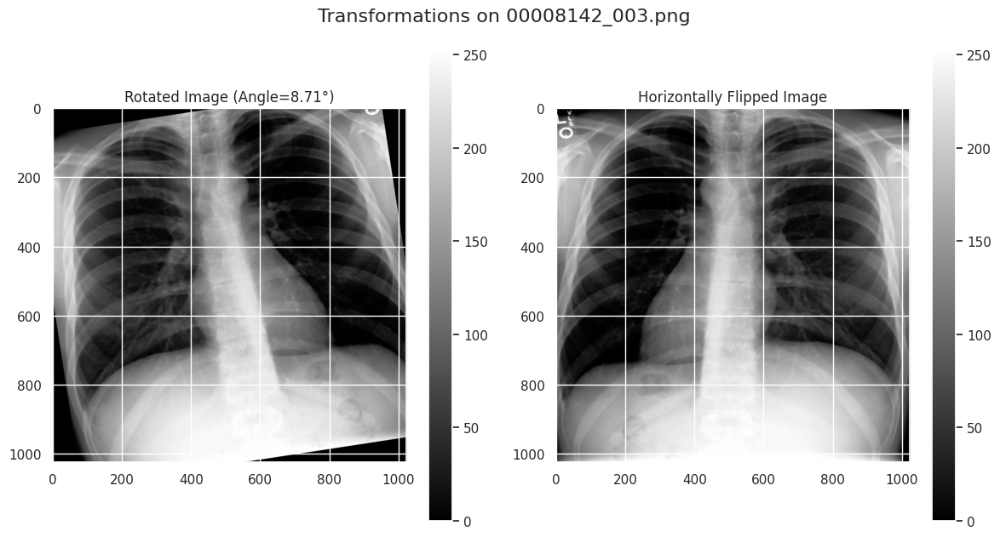

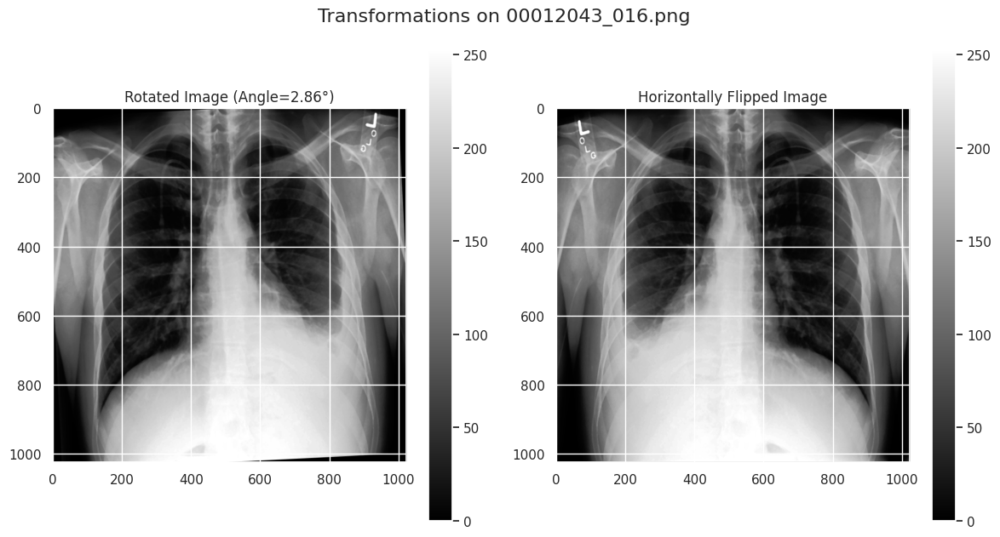

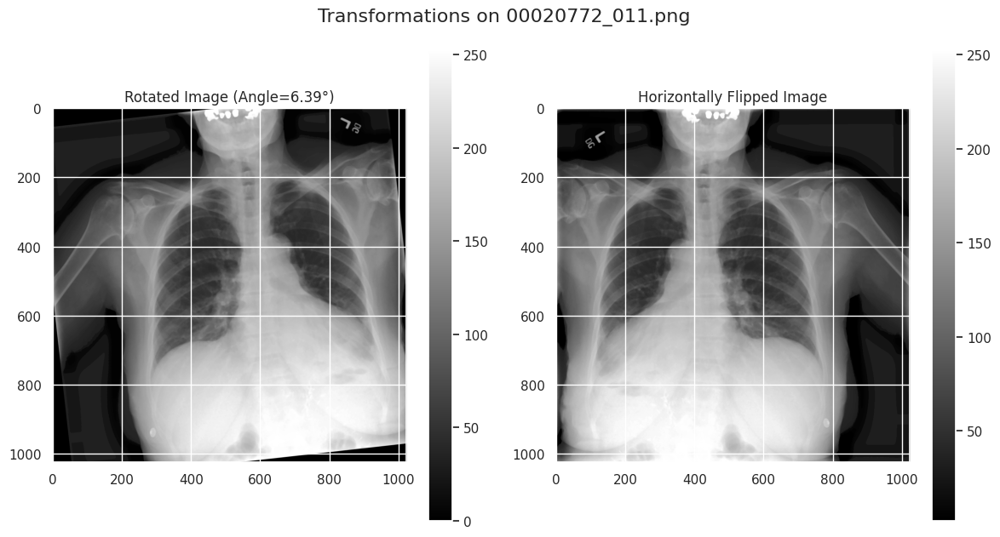

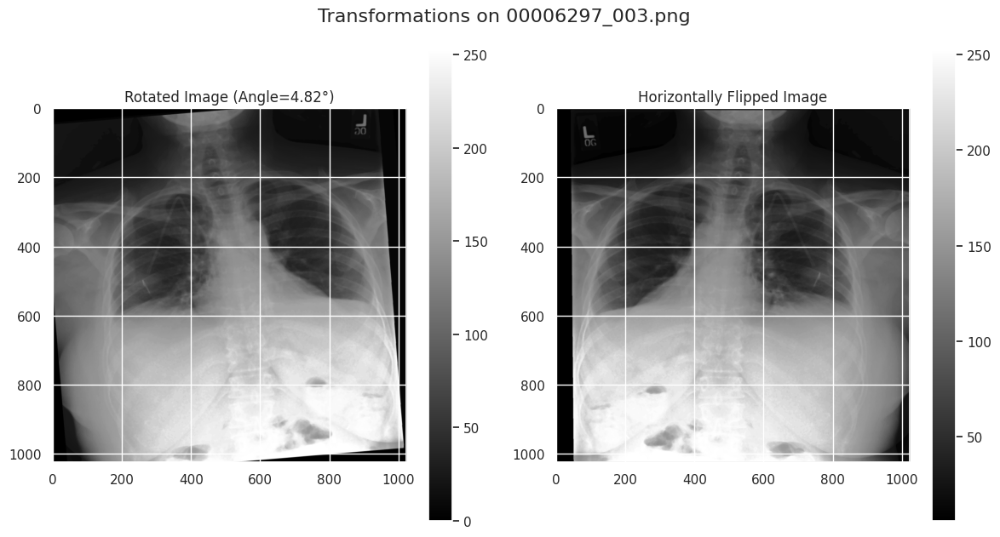

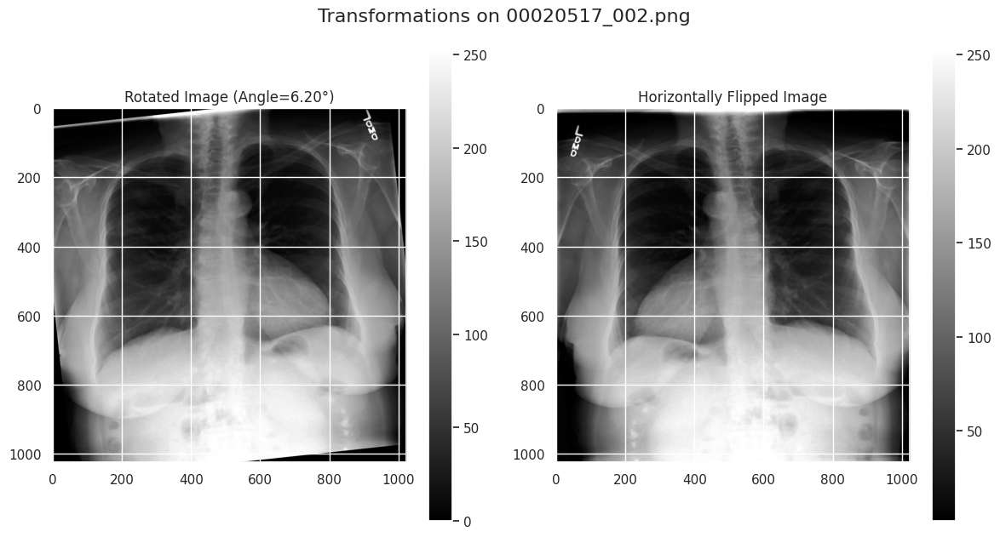

In [ ]:
# Gamma değeri
gamma = 1.2

# İşlemleri her bir görüntü için uygula
for img_name in image_list:
    # Görüntü yolunu oluştur ve yükle
    img_path = os.path.join(img_dir, img_name)
    raw_image = imread(img_path)

    # Step 1: Apply contrast stretching
    min_val, max_val = raw_image.min(), raw_image.max()
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize to [0, 1]
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # Scale to [0, 255]

    # Step 2: Apply histogram equalization
    equalized_image = exposure.equalize_hist(contrast_stretched)  # Normalize to [0, 1]
    equalized_image = (equalized_image * 255).astype(np.uint8)    # Scale to [0, 255]

    # Step 3: Apply gamma correction
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Apply Median Filtering
    median_filtered = cv2.medianBlur(gamma_corrected, 5)

    # Apply rotation with a random angle between 0 and 10
    random_angle = np.random.uniform(0, 10)  # Rastgele açı
    center = (median_filtered.shape[1] // 2, median_filtered.shape[0] // 2)
    rotation_matrix = cv2.getRotationMatrix2D(center, angle=random_angle, scale=1.0)
    rotated_image = cv2.warpAffine(median_filtered, rotation_matrix,
                                   (median_filtered.shape[1], median_filtered.shape[0]))

    # Apply horizontal flip
    flipped_horizontal = cv2.flip(median_filtered, 1)

    # Display Results
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.imshow(rotated_image, cmap='gray')
    plt.title(f"Rotated Image (Angle={random_angle:.2f}°)")
    plt.colorbar()

    plt.subplot(1, 2, 2)
    plt.imshow(flipped_horizontal, cmap='gray')
    plt.title("Horizontally Flipped Image")
    plt.colorbar()

    plt.tight_layout()
    plt.suptitle(f"Transformations on {img_name}", y=1.05, fontsize=16)
    plt.show()


**Rotasyon (Rotation):** Her bir görüntüyü rastgele seçilen bir açıyla (0 ila 10 derece arasında) döndürdüm. Bu işlem, görüntülerin pozisyonlarını değiştirerek veri çeşitliliğini artırır. Örneğin, makine öğrenimi modellerinin eğitimi sırasında, farklı açılardaki varyasyonlara karşı daha dayanıklı hale gelmesini sağlar.

**Yatay Çevirme (Horizontal Flipping):** Görüntüleri yatay olarak çevirdiniz (sol-sağ ters çevirme). Bu işlem, veriyi çoğaltmak ve modelin görüntülerin simetrik özelliklerini öğrenmesini sağlamak için kullanılır. Özellikle simetrik yapılar (örneğin, akciğerler) üzerinde modelin daha esnek olmasına yardımcı olur.

Görüntülere yukarıdaki yaptığım işlemlerde  hem görüntülerin kalitesini artırdım **(median filtre)** hem de veri setini çeşitlendirdim (rotasyon ve flipping). Bu, makine öğrenimi modellerinin genelleme kabiliyetini artırır ve performansını iyileştirir.

### 6. Frekans Alanında Filtreleme:
      1.	Fourier Dönüşümü ve Filtreleme: Fourier dönüşümü ile görüntüyü frekans alanına çevirin, düşük frekansları geçiren bir maske uygulayın
      ardından ters Fourier dönüşümü ile frekans alanında filtreleme yapın.


**Fourier Dönüşümü ve Filtreleme İşlemleri:**

Fourier dönüşümü, bir görüntüyü uzay alanından (piksel değerlerinden oluşan görüntü) frekans alanına dönüştüren matematiksel bir işlemdir. Bu, görüntünün içindeki farklı frekans bileşenlerini analiz etmemize ve düzenlememize olanak tanır.

**NOT: Düşük Frekans Filtresi ile Adımları:**

-Fourier Dönüşümü: Görüntü frekans alanına çevrilir.

-Maske Uygulaması: Frekans alanında, belirli bir eşik değerin altındaki (düşük frekans) bileşenler geçer, diğerleri kaldırılır.

-Ters Fourier Dönüşümü: Frekans alanından elde edilen filtrelenmiş veriler tekrar uzay alanına dönüştürülür.

-Sonuç: Daha yumuşak, gürültüsü azaltılmış bir görüntü elde edilir.

### **ÖRNEK 1 RESİM ÜZERİNDE UYGULANIŞI:**

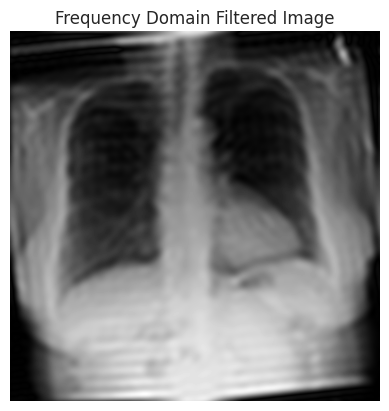

In [ ]:
# Apply Fourier Transform and shift it to center low frequencies
dft = cv2.dft(np.float32(rotated_image), flags=cv2.DFT_COMPLEX_OUTPUT)
dft_shifted = np.fft.fftshift(dft)

# Create a mask for filtering
rows, cols = rotated_image.shape
crow, ccol = rows // 2 , cols // 2
mask = np.zeros((rows, cols, 2), np.uint8)
mask[crow-30:crow+30, ccol-30:ccol+30] = 1  # Center low frequencies pass

# Apply mask and inverse DFT
fshift = dft_shifted * mask
f_ishift = np.fft.ifftshift(fshift)
filtered_image = cv2.idft(f_ishift)
filtered_image = cv2.magnitude(filtered_image[:, :, 0], filtered_image[:, :, 1])

# Normalize and display the filtered image
filtered_image = cv2.normalize(filtered_image, None, 0, 255, cv2.NORM_MINMAX)
plt.imshow(filtered_image, cmap='gray')
plt.title("Frequency Domain Filtered Image")
plt.axis("off")
plt.show()


### **SEÇTİĞİMİZ 9 GÖRÜNTÜ ÜZERİNDE BU ÖZELLİĞİN UYGULANIŞI:**

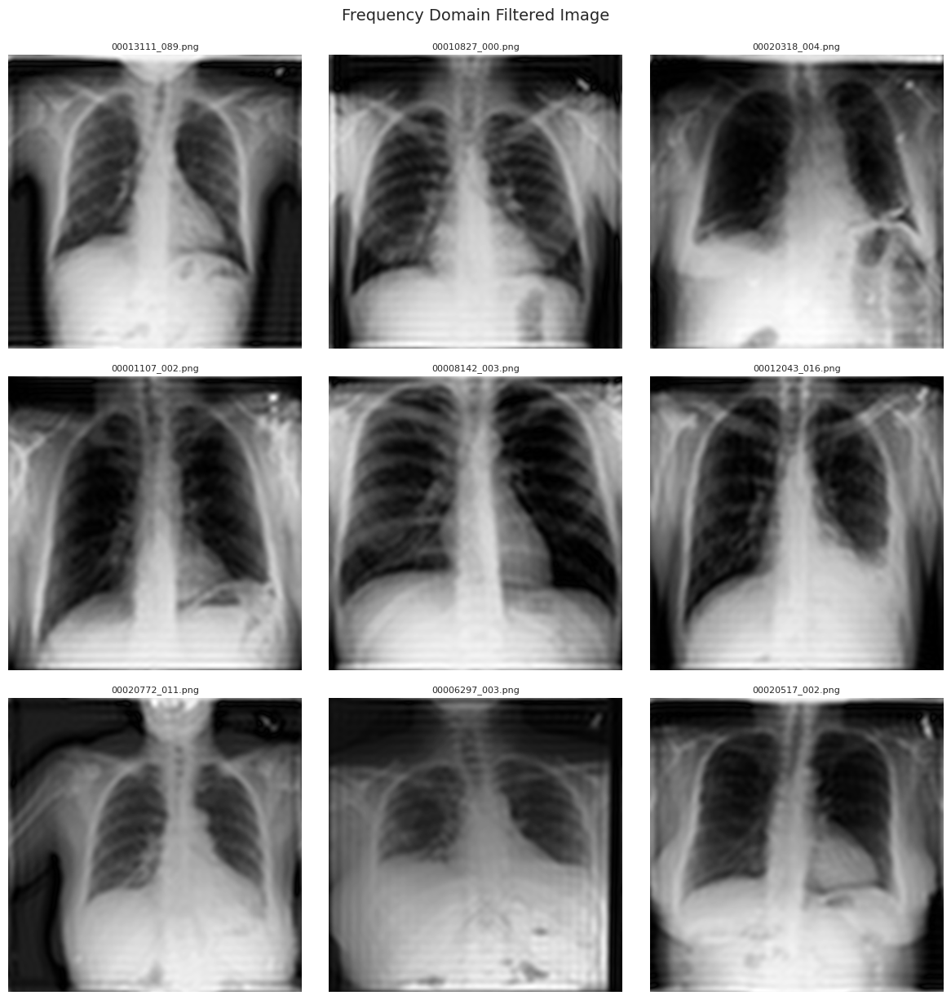

In [ ]:
# Görüntülerin bulunduğu klasörün yolu
img_dir = 'nih/images_small/'  # Görüntülerin olduğu dizin

# Görüntü dosya adları
image_list = [
    "00013111_089.png",
    "00010827_000.png",
    "00020318_004.png",
    "00001107_002.png",
    "00008142_003.png",
    "00012043_016.png",
    "00020772_011.png",
    "00006297_003.png",
    "00020517_002.png"
]

# Gamma değeri
gamma = 1.2

# Satır ve sütun sayısı
rows = len(image_list) // 3 + (len(image_list) % 3 > 0)  # 3'erli olacak şekilde kaç satır gerekiyor
cols = 3

# Görüntüleri yan yana 3'er şekilde çizdirme
fig, axes = plt.subplots(rows, cols, figsize=(12, 4 * rows))  # Görüntü boyutlarını küçülttüm

# İşlemleri her bir görüntü için uygula
for idx, img_name in enumerate(image_list):
    # Görüntü yolunu oluştur ve yükle
    img_path = os.path.join(img_dir, img_name)
    raw_image = imread(img_path)

    # Step 1: Apply contrast stretching
    min_val, max_val = raw_image.min(), raw_image.max()
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize to [0, 1]
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # Scale to [0, 255]

    # Step 2: Apply histogram equalization
    equalized_image = exposure.equalize_hist(contrast_stretched)  # Normalize to [0, 1]
    equalized_image = (equalized_image * 255).astype(np.uint8)    # Scale to [0, 255]

    # Step 3: Apply gamma correction
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Apply Median Filtering
    median_filtered = cv2.medianBlur(gamma_corrected, 5)

    # Fourier Transform and filtering
    dft = cv2.dft(np.float32(median_filtered), flags=cv2.DFT_COMPLEX_OUTPUT)
    dft_shifted = np.fft.fftshift(dft)

    # Create a mask for filtering
    rows_img, cols_img = median_filtered.shape
    crow, ccol = rows_img // 2, cols_img // 2
    mask = np.zeros((rows_img, cols_img, 2), np.uint8)
    mask[crow-30:crow+30, ccol-30:ccol+30] = 1  # Center low frequencies pass

    # Apply mask and inverse DFT
    fshift = dft_shifted * mask
    f_ishift = np.fft.ifftshift(fshift)
    filtered_image = cv2.idft(f_ishift)
    filtered_image = cv2.magnitude(filtered_image[:, :, 0], filtered_image[:, :, 1])

    # Normalize the filtered image
    filtered_image = cv2.normalize(filtered_image, None, 0, 255, cv2.NORM_MINMAX)

    # Plot in the grid
    row, col = divmod(idx, cols)
    ax = axes[row, col] if rows > 1 else axes[col]
    ax.imshow(filtered_image, cmap='gray')
    ax.set_title(f"{img_name}", fontsize=8)  # Başlık boyutunu küçülttüm
    ax.axis('off')

# Boş kalan hücreleri kaldır
if len(image_list) % cols != 0:
    for i in range(len(image_list), rows * cols):
        fig.delaxes(axes.flatten()[i])

plt.tight_layout()
plt.suptitle("Frequency Domain Filtered Image", y=1.02, fontsize=14)
plt.show()


**Yukarıdaki görüntülerde:**

Fourier dönüşümü ve düşük frekans filtresi ile görüntüdeki genel yapıların daha iyi analiz edilmesini sağladık. Gürültülerin giderilmesi ve yumuşatma gibi görevler için bir araç olarak kullanılabiliriz.

### 7. Keskinleştirme ve Enterpolasyon
    1.	Keskinleştirme: Unsharp masking tekniği kullanarak görüntüyü keskinleştirin.
    2.	Bicubic Enterpolasyon : Keskinleştirilmiş görüntüyü iki kat büyüterek enterpolasyon uygulayın.


### **ÖRNEK BİR GÖRÜNTÜ ÜZERİNDE UYGULANIŞI:**

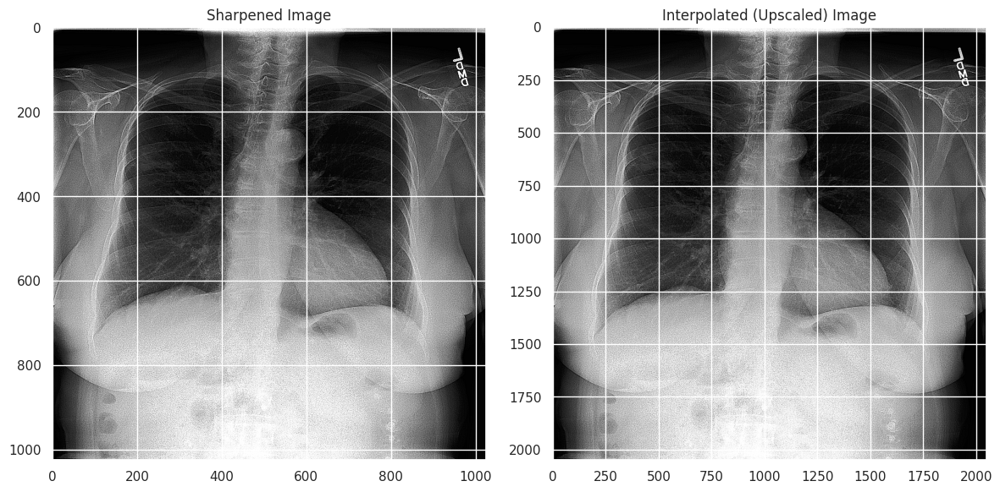

In [ ]:
from scipy.ndimage import zoom

# Step 4: Apply sharpening using an unsharp masking kernel
sharpening_kernel = np.array([[-1, -1, -1],
                              [-1,  9, -1],
                              [-1, -1, -1]])
sharpened_image = np.clip(cv2.filter2D(gamma_corrected, -1, sharpening_kernel), 0, 255).astype(np.uint8)

# Step 5: Apply bicubic interpolation to upscale the image by a factor of 2
scale_factor = 2
resized_image = zoom(sharpened_image, scale_factor, order=3)  # Bicubic interpolation with `order=3`

plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1), plt.imshow(sharpened_image, cmap='gray'),plt.title("Sharpened Image")
plt.subplot(1, 2, 2), plt.imshow(resized_image, cmap='gray'),plt.title("Interpolated (Upscaled) Image")


plt.tight_layout()
plt.show()

### **BU ÖZELLİĞİN 9 GÖRÜNTÜYE DE UYGULANMASI:**

### **Görüntülerde yaptığımız işlemler:**

**Keskinleştirme (Unsharp Masking):**

Görüntüde detayları ve kenarları vurgulamak için keskinleştirme filtresi uygulandı. Kullanılan çekirdek, yüksek frekansları artırarak görüntüyü daha net hale getirir.

**Bicubic Enterpolasyon (İki Kat Büyütme):**

Keskinleştirilmiş görüntü, scipy.ndimage.zoom fonksiyonu ile iki kat büyütüldü.
Bicubic enterpolasyon (order=3) kullanıldı, bu da büyütme sırasında yüksek kalite sağlar.

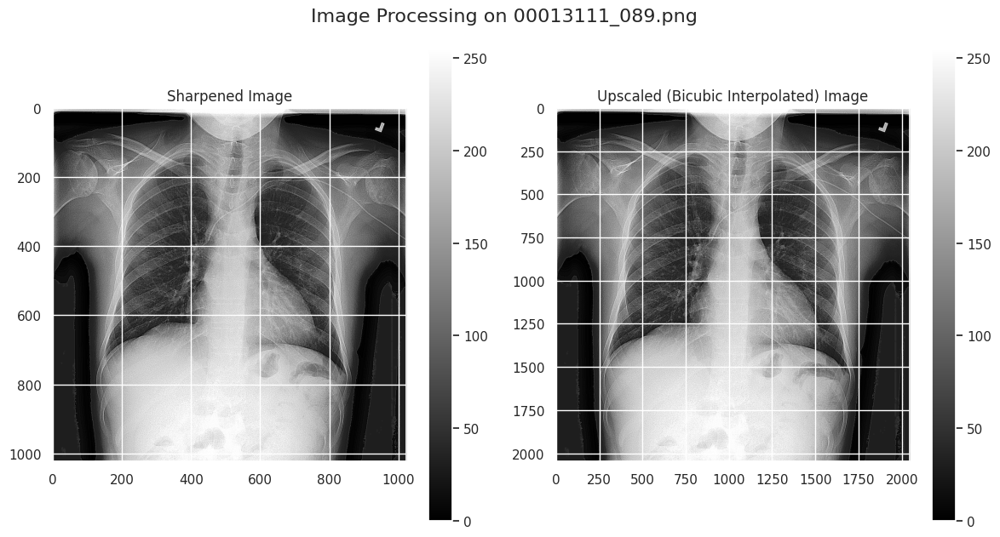

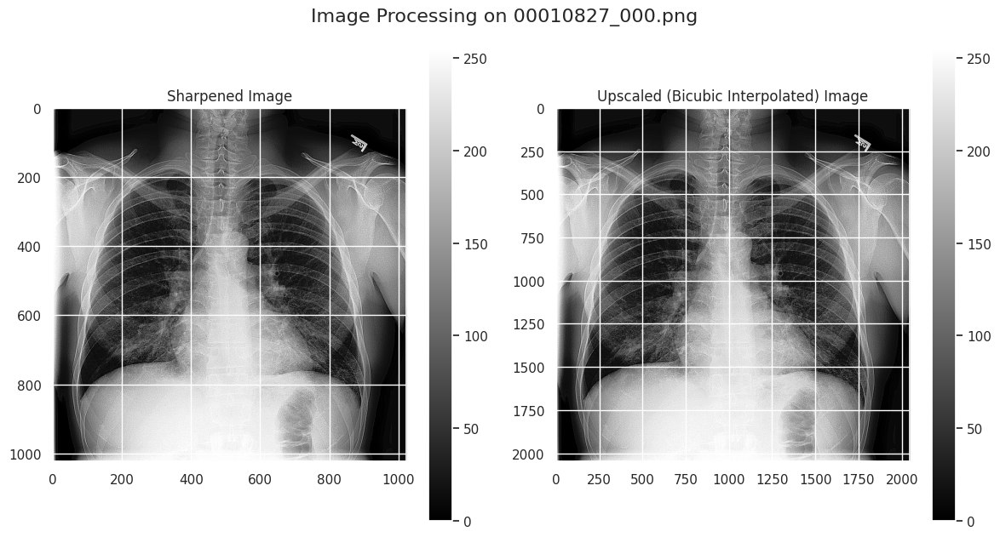

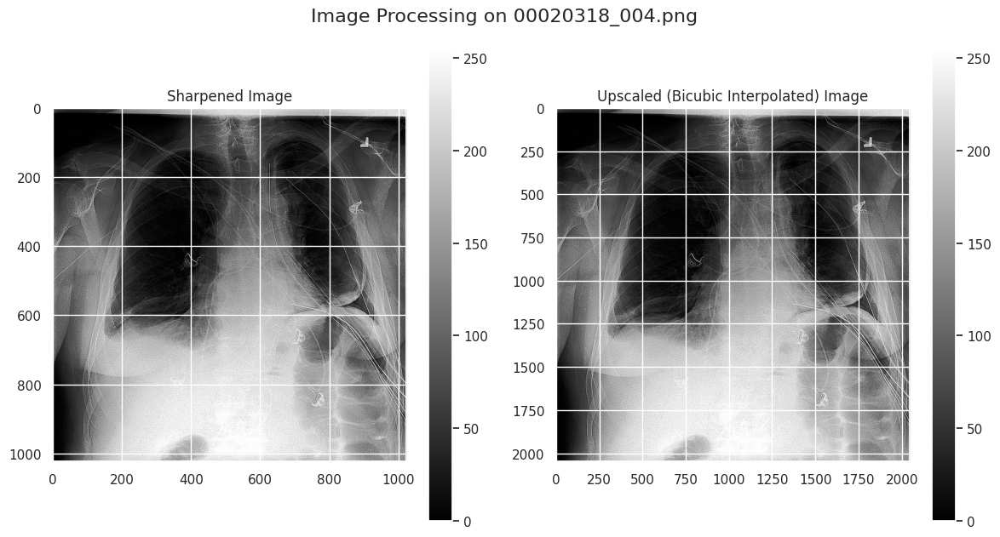

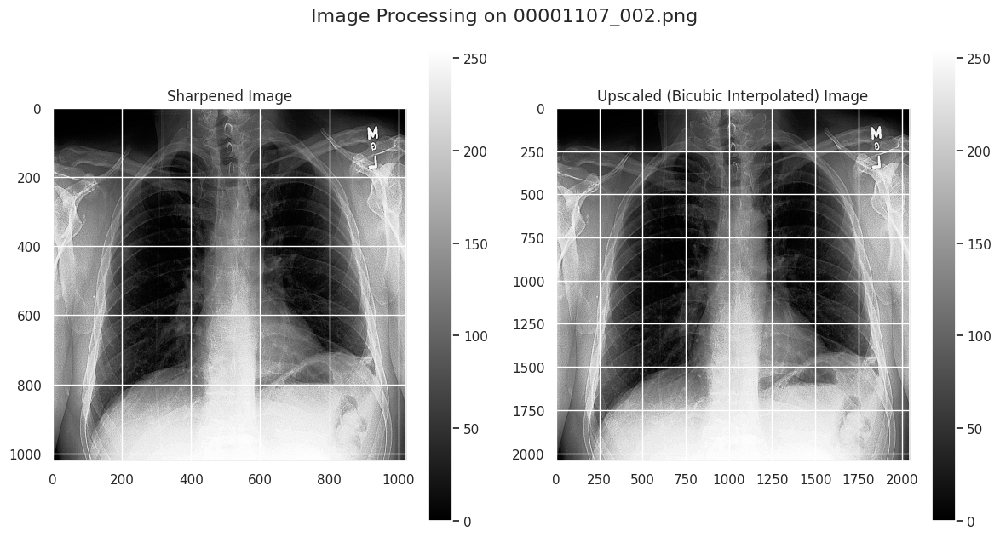

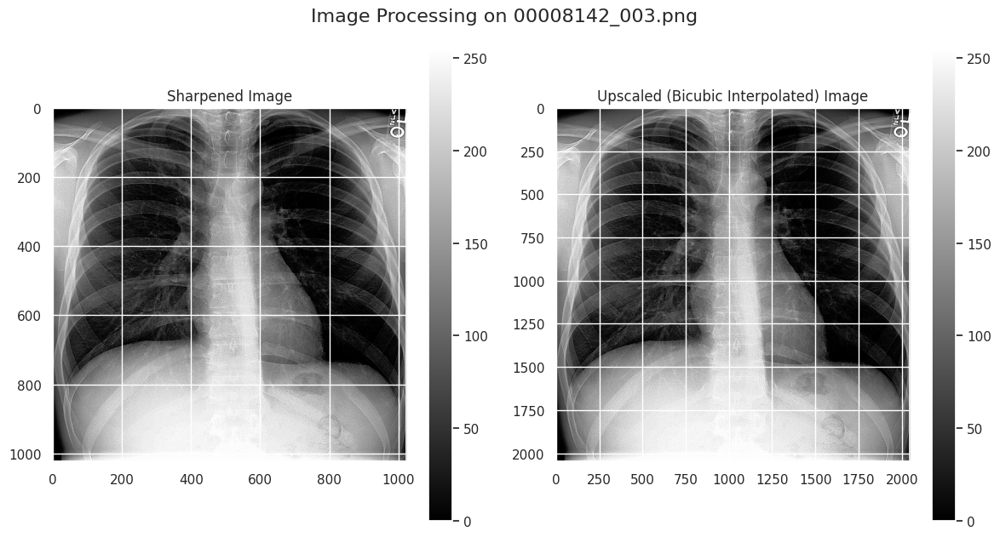

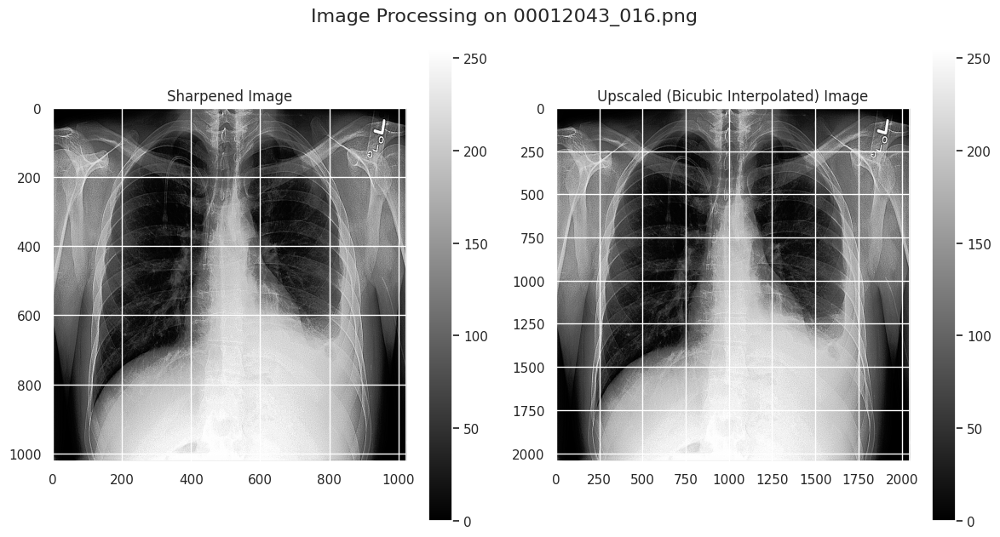

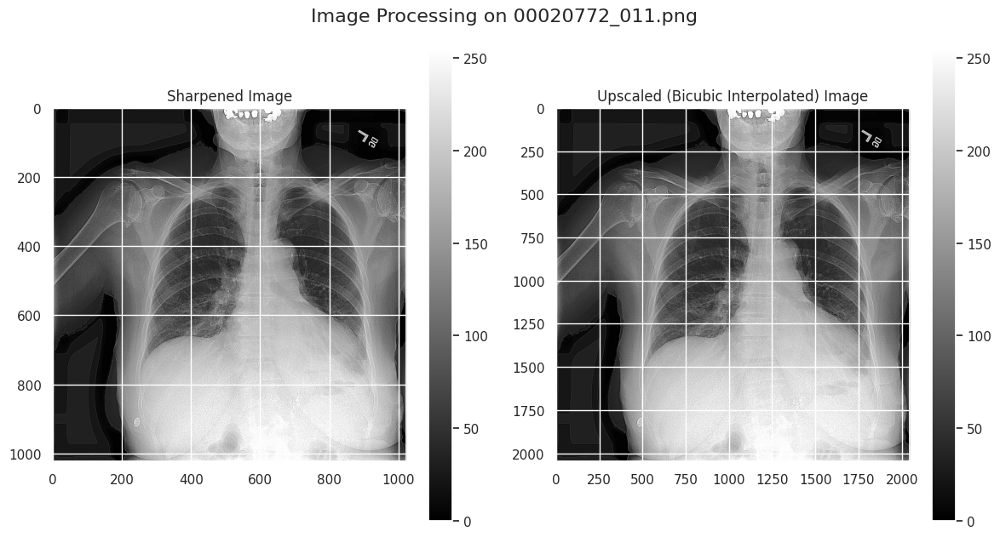

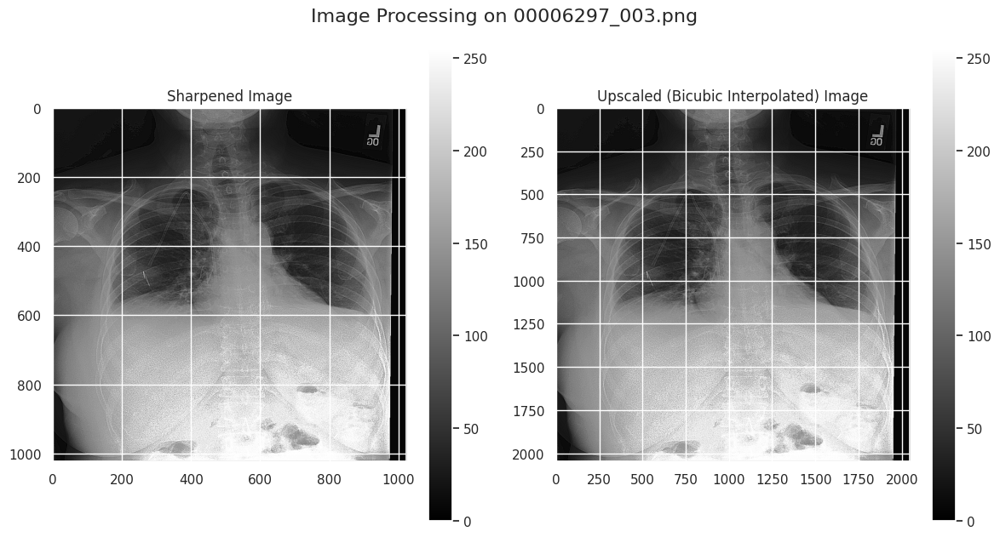

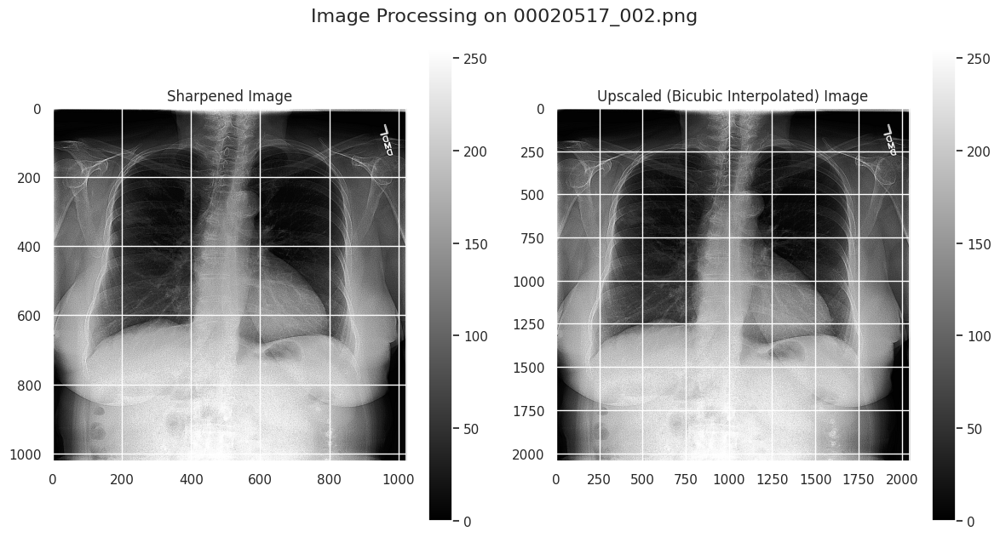

In [ ]:
# Görüntülerin bulunduğu klasörün yolu
img_dir = 'nih/images_small/'  # Görüntülerin olduğu dizin

# Görüntü dosya adları
image_list = [
    "00013111_089.png",
    "00010827_000.png",
    "00020318_004.png",
    "00001107_002.png",
    "00008142_003.png",
    "00012043_016.png",
    "00020772_011.png",
    "00006297_003.png",
    "00020517_002.png"
]

# Gamma değeri
gamma = 1.2

# İşlemleri her bir görüntü için uygula
for img_name in image_list:
    # Görüntü yolunu oluştur ve yükle
    img_path = os.path.join(img_dir, img_name)
    raw_image = imread(img_path)

    # Step 1: Apply contrast stretching
    min_val, max_val = raw_image.min(), raw_image.max()
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize to [0, 1]
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # Scale to [0, 255]

    # Step 2: Apply histogram equalization
    equalized_image = exposure.equalize_hist(contrast_stretched)  # Normalize to [0, 1]
    equalized_image = (equalized_image * 255).astype(np.uint8)    # Scale to [0, 255]

    # Step 3: Apply gamma correction
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Step 4: Apply sharpening using an unsharp masking kernel
    sharpening_kernel = np.array([[-1, -1, -1],
                                   [-1,  9, -1],
                                   [-1, -1, -1]])
    sharpened_image = np.clip(cv2.filter2D(gamma_corrected, -1, sharpening_kernel), 0, 255).astype(np.uint8)

    # Step 5: Apply bicubic interpolation to upscale the image by a factor of 2
    scale_factor = 2
    resized_image = zoom(sharpened_image, scale_factor, order=3)  # Bicubic interpolation with `order=3`

    # Display Results
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.imshow(sharpened_image, cmap='gray')
    plt.title(f"Sharpened Image")
    plt.colorbar()

    plt.subplot(1, 2, 2)
    plt.imshow(resized_image, cmap='gray')
    plt.title("Upscaled (Bicubic Interpolated) Image")
    plt.colorbar()

    plt.tight_layout()
    plt.suptitle(f"Image Processing on {img_name}", y=1.05, fontsize=16)
    plt.show()


**Bu kod, her bir görüntü için keskinleştirme ve enterpolasyon işlemlerini uygulayarak sonuçları görselleştirdim.**

Keskinleştirme (Unsharp Masking): Görüntülerin kenarlarını ve detaylarını daha belirgin hale getirdik, böylece netlik sağladık.

Bicubic Enterpolasyon: Keskinleştirilmiş görüntüleri yüksek kaliteli bir şekilde iki kat büyüterek çözünürlüklerini artırdık.

Kısacası: Görüntülerin hem netliğini artırdık hem de büyütme işlemi sırasında detayların korunmasını sağladık. Bu, özellikle yüksek çözünürlük ve detay gerektiren uygulamalar için önemli bir adım oldu.